# Visualizing America's Energy Transformation

## Project Team

**Team Members:**
- Evan Klein
- Murun Tsogtkhuyag  
- Sundaravadivelnathan Ponnusamy

## Abstract

The United States energy grid is an important and critical piece of infrastructure which is under constant stress and evolution due to a variety of factors. Common concerns regarding transition and change within the energy sector include **reliability**, **economics**, **emissions**, and **increased demand**.

This report serves to provide an overview of certain challenges and effects to the energy system given numerous data sources from the Energy Information Administration. Some of these effects include:

1. **Dramatic shifts in national and state fuel mix portfolios** - The distribution of energy sources utilized to provide power has shifted greatly in the last 20 years due to climate concerns, legislation, and fluctuating demand.

2. **Distribution-level reliability has shifted nation-wide** - Very few regions seeing improvement in key metrics. We study standard reliability metrics like SAIFI and SAIDI, which are defined and explored over time in order to paint a picture of a decaying distribution system.

3. **Increasing energy prices** - Plaguing every sector of the economy especially in the years post-pandemic.

Given these existing challenges which are already impossible to ignore, as well as additional factors and growth in demand due to large-scale infrastructure investment in data centers and AI, **the outlook for energy consumers in the United States is unfortunately trending downwards**.

## Introduction

The United States energy system is a **critical piece of infrastructure** which plays an important role in the lives of most Americans today. Reliable power sustains homes, workplaces, schools, and hospitals, and is an upstream requirement of other critical infrastructure such as wastewater treatment and construction.

Changes to, and disruptions of, shared energy systems and technology are typically considered critical, and large numbers of resources are made available by state and federal authorities to ensure the smooth and continued flow of power throughout communities.

### Current Grid Challenges

The United States power grid is very large, uniquely positioned, and faced with a number of challenges in recent years:

- **Decommissioning of fossil fuel resources**
- **Introduced volatility of renewables**
- **Larger than expected demand increases** due to pressing infrastructure construction by frontier AI companies in the data center space

### Data-Driven Analysis Approach

The energy sector is highly saturated in data, which is a double-edged sword. Transmission authorities such as RTOs (Regional Transmission Organizations) regularly source and utilize data to assist in operations, build compelling visualizations and dashboards, and implement machine learning algorithmic models, but are routinely challenged by the sheer influx of data made available.

Data made publicly available by the **Energy Information Administration** is what made this research possible and allowed our visualization methods to be compiled.

## Current Visualization Landscape

### Existing Solutions & Their Limitations

Visualizations within the energy sector are common and made publicly available by transmission authorities such as **ERCOT** and **MISO**, or by 3rd-party non-authorities such as **GridStatus.io**. These visualizations are useful for monitoring, but with the prevalence and quantity of data we often find that some visualizations do not take full advantage of the data provided.

#### Example: MISO Fuel Mix Visualization
- Shows helpful snapshot of fuel mix within MISO footprint
- **Limitation**: Fails to paint adequate picture of fuel mix journey throughout the day or other time periods

#### Example: GridStatus.io Improvements
- Better fuel mix resource allowing visualization over course of a day
- **Limitations**:
  - Lacking in scope of footprint and time coverage
  - Insufficient for understanding transitioning American energy system nationally

#### Example: Historical Energy Use Visualizations
- Shows 200+ year trends without proper legends or data labels
- Missing granular detail needed for comprehensive analysis

**Key Problems with Current Visualizations:**
- Limited scope of footprint and time coverage
- Lack of long-term trend analysis at national scale
- Insufficient granular detail for understanding transitions
- Missing focus on critical reliability metrics

To understand the transitioning American energy system, it is important to understand fuel mix **nationally** and across a **large timespan**. Capturing these long-term trends on a highly granular level will help viewers understand how the fuel mix has changed over time and how that has affected other key metrics such as energy price and reliability.

## Focus on Reliability Metrics

One key area worth studying but which is rarely visualized by popular energy visualization platforms is **reliability**. Reliability is measured and reported in a number of different ways, typically via indexes which track metrics related to outages.

### Key Reliability Indices

According to the U.S. Energy Information Administration (2024):

**SAIDI** - *System Average Interruption Duration Index*  
The minutes of non-momentary electric interruptions, per year, the average customer experienced

**SAIFI** - *System Average Interruption Frequency Index*  
The number of non-momentary electric interruptions, per year, the average customer experienced

**CAIDI** - *Customer Average Interruption Duration Index*  
The average number of minutes it takes to restore non-momentary electric interruptions

### Research Hypothesis

Visualizing these indices, especially over time and faceting by region or state can help us pinpoint where in the United States distribution reliability is beginning to sag. The visualizations built with this data should provide a concrete understanding of a decline in a category of standard of living for millions of Americans.

**Our expectation:** Distribution reliability has generally trended downwards over the last decade.

## Data Sources & Methodology

### Data Sources

Our analysis utilized numerous publicly available datasets provided by the **Energy Information Administration**, including:

- **CSV files** containing historical energy production data
- **Excel spreadsheets** with state and regional energy statistics  
- **API endpoints** providing real-time and historical energy data
- **Reliability metrics** (SAIFI, SAIDI, CAIDI) from EIA Tables 11.4, 11.5, and 11.6

Additional data sources examined:
- Kaggle datasets on nuclear energy
- Open Power System Data platform (international power data)
- Federal Energy Regulatory Commission (FERC) data

### Regional Classifications

For analysis purposes, we defined regions as follows:

- **Eastern Region**: Connecticut, Delaware, Maine, Maryland, New Hampshire, New Jersey, New York, Pennsylvania, Rhode Island, Vermont
- **Midwestern Region**: Illinois, Indiana, Iowa, Kansas, Michigan, Minnesota, Missouri, Nebraska, North Dakota, Ohio, South Dakota, Wisconsin  
- **Southern Region**: Alabama, Arkansas, Florida, Georgia, Kentucky, Louisiana, Mississippi, North Carolina, South Carolina, Tennessee, Virginia, West Virginia
- **Southwest Region**: Arizona, New Mexico, Oklahoma, Texas
- **Western Region**: California, Colorado, Idaho, Montana, Nevada, Oregon, Utah, Washington, Wyoming
- **Noncontiguous Region**: Hawaii, Alaska

### Technical Implementation

**Visualization Libraries:**
- `seaborn` and `matplotlib` for statistical visualizations
- `plotly express` for interactive choropleth maps
- `folium` for detailed interactive mapping (replacing `ipyleaflet` due to performance issues)
- `pandas` and `numpy` for data processing and analysis

**Key Technical Challenge Solved:**
- Initial mapping with `ipyleaflet` took ~20 minutes per iteration for 14,170 data points
- Switched to `folium` for rapid rendering and efficient iteration
- Implemented proportional circle markers with capacity-based sizing and interactive tooltips



## Analysis Sections

### Energy Production Landscape
*Temporal and geographic analysis of America's shifting energy mix from 1973-2024*

In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import requests
from io import StringIO

# Download and Load the Data Table_1.2_Primary_Energy_Production_by_Source
# URL for the EIA CSV file
#url = 'https://www.eia.gov/totalenergy/data/browser/csv.php?tbl=T01.02'
#response = requests.get(url)
#df_read = pd.read_csv(StringIO(response.text))

df_read = pd.read_csv('data/MER_T01_02.csv') # local copy

# Data exploration
print(df_read.head())
print(df_read.info())

# Get unique descriptions to understand the data
print(df_read['Description'].unique())

       MSN  YYYYMM      Value  Column_Order      Description             Unit
0  CLPRBUS  194913  11.973882             1  Coal Production  Quadrillion Btu
1  CLPRBUS  195013  14.060135             1  Coal Production  Quadrillion Btu
2  CLPRBUS  195113  14.419325             1  Coal Production  Quadrillion Btu
3  CLPRBUS  195213  12.734313             1  Coal Production  Quadrillion Btu
4  CLPRBUS  195313  12.277746             1  Coal Production  Quadrillion Btu
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 9217 entries, 0 to 9216
Data columns (total 6 columns):
 #   Column        Non-Null Count  Dtype 
---  ------        --------------  ----- 
 0   MSN           9217 non-null   object
 1   YYYYMM        9217 non-null   int64 
 2   Value         9217 non-null   object
 3   Column_Order  9217 non-null   int64 
 4   Description   9217 non-null   object
 5   Unit          9217 non-null   object
dtypes: int64(2), object(4)
memory usage: 432.2+ KB
None
['Coal Production' 'Natural Gas (

In [2]:
df = df_read.copy()

# Convert 'Value' to numeric, coercing errors to NaN
df['Value'] = pd.to_numeric(df['Value'], errors='coerce')

# Drop rows with NaN in 'Value'
df.dropna(subset=['Value'], inplace=True)

# Filter out the rows where the month is 13 as it is the total for the year
df = df[df['YYYYMM'] % 100 != 13]

# Extract date attributes from the 'YYYYMM' column
df['Date'] = pd.to_datetime(df['YYYYMM'], format='%Y%m')
df['Year'] = df['YYYYMM'] // 100
df['Month'] = df['YYYYMM'] % 100

# Exclude the current year (2025)
df = df[df['Year'] != 2025]

# Filter out descriptions starting with 'Total' as they are aggregate
clean_df = df[(~df['Description'].str.startswith('Total'))]

# Display the first 5 rows of the filtered dataframe
print(clean_df.head())

        MSN  YYYYMM     Value  Column_Order      Description             Unit  \
24  CLPRBUS  197301  1.166486             1  Coal Production  Quadrillion Btu   
25  CLPRBUS  197302  1.086072             1  Coal Production  Quadrillion Btu   
26  CLPRBUS  197303  1.196571             1  Coal Production  Quadrillion Btu   
27  CLPRBUS  197304  1.112230             1  Coal Production  Quadrillion Btu   
28  CLPRBUS  197305  1.216978             1  Coal Production  Quadrillion Btu   

         Date  Year  Month  
24 1973-01-01  1973      1  
25 1973-02-01  1973      2  
26 1973-03-01  1973      3  
27 1973-04-01  1973      4  
28 1973-05-01  1973      5  


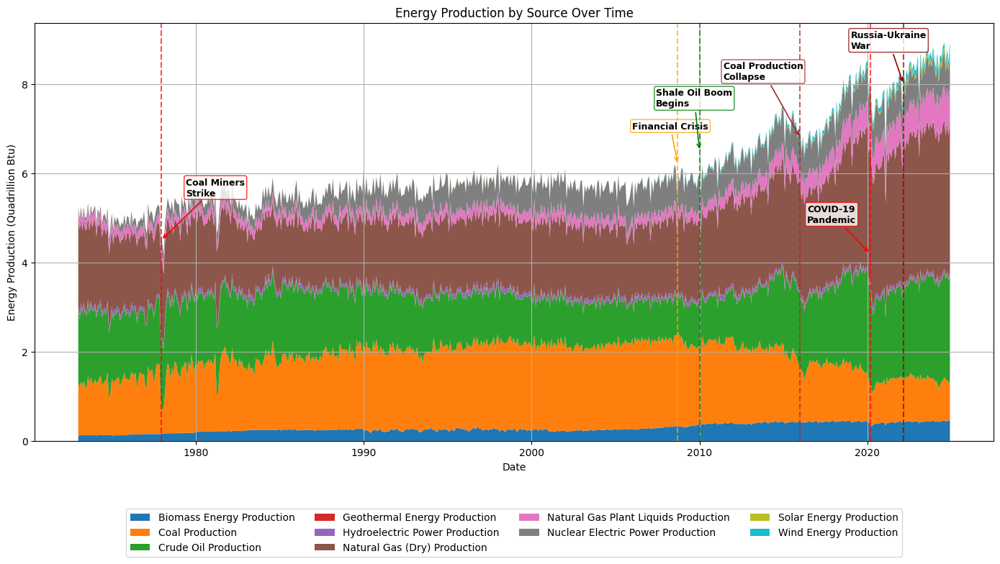

In [3]:
# Prepare Data for Stacked Area Chart

# Pivot the table to have the Date as index, descriptions as columns
pivot_df = clean_df.pivot_table(index='Date', columns='Description', values='Value', aggfunc='sum')

# Stacked area chart
plt.figure(figsize=(14, 8))
plt.stackplot(pivot_df.index, pivot_df.values.T, labels=pivot_df.columns)

# Add vertical lines for each event
plt.axvline(x=pd.to_datetime('1977-12-06'), color='red', linestyle='--', alpha=0.7, linewidth=1.5)
plt.axvline(x=pd.to_datetime('2008-09-15'), color='orange', linestyle='--', alpha=0.7, linewidth=1.5)
plt.axvline(x=pd.to_datetime('2010-01-01'), color='green', linestyle='--', alpha=0.7, linewidth=1.5)
plt.axvline(x=pd.to_datetime('2016-01-01'), color='brown', linestyle='--', alpha=0.7, linewidth=1.5)
plt.axvline(x=pd.to_datetime('2020-03-01'), color='red', linestyle='--', alpha=0.7, linewidth=1.5)
plt.axvline(x=pd.to_datetime('2022-02-24'), color='darkred', linestyle='--', alpha=0.7, linewidth=1.5)

# Energy Crisis and Economic Events
plt.annotate('Coal Miners\nStrike',
             xy=(pd.to_datetime('1977-12-06'), 4.5),
             xytext=(pd.to_datetime('1979-06-01'), 5.5),
             arrowprops=dict(arrowstyle='->', color='red', lw=1.2),
             fontsize=9, fontweight='bold',
             bbox=dict(boxstyle="round,pad=0.2", facecolor='white', edgecolor='red', alpha=0.8))

plt.annotate('Financial Crisis',
             xy=(pd.to_datetime('2008-09-15'), 6.2),
             xytext=(pd.to_datetime('2006-01-01'), 7.0),
             arrowprops=dict(arrowstyle='->', color='orange', lw=1.2),
             fontsize=9, fontweight='bold',
             bbox=dict(boxstyle="round,pad=0.2", facecolor='white', edgecolor='orange', alpha=0.8))

plt.annotate('Shale Oil Boom\nBegins',
             xy=(pd.to_datetime('2010-01-01'), 6.5),
             xytext=(pd.to_datetime('2007-06-01'), 7.5),
             arrowprops=dict(arrowstyle='->', color='green', lw=1.2),
             fontsize=9, fontweight='bold',
             bbox=dict(boxstyle="round,pad=0.2", facecolor='white', edgecolor='green', alpha=0.8))

plt.annotate('Coal Production\nCollapse',
             xy=(pd.to_datetime('2016-01-01'), 6.8),
             xytext=(pd.to_datetime('2011-06-01'), 8.1),
             arrowprops=dict(arrowstyle='->', color='brown', lw=1.2),
             fontsize=9, fontweight='bold',
             bbox=dict(boxstyle="round,pad=0.2", facecolor='white', edgecolor='brown', alpha=0.8))

plt.annotate('COVID-19\nPandemic',
             xy=(pd.to_datetime('2020-03-01'), 4.2),
             xytext=(pd.to_datetime('2016-06-01'), 4.9),
             arrowprops=dict(arrowstyle='->', color='red', lw=1.2),
             fontsize=9, fontweight='bold',
             bbox=dict(boxstyle="round,pad=0.2", facecolor='white', edgecolor='red', alpha=0.8))

plt.annotate('Russia-Ukraine\nWar',
             xy=(pd.to_datetime('2022-02-24'), 8.0),
             xytext=(pd.to_datetime('2019-01-01'), 8.8),
             arrowprops=dict(arrowstyle='->', color='darkred', lw=1.2),
             fontsize=9, fontweight='bold',
             bbox=dict(boxstyle="round,pad=0.2", facecolor='white', edgecolor='darkred', alpha=0.8))

# Add title, labels, and Legend outside chart at bottom
plt.title('Energy Production by Source Over Time')
plt.xlabel('Date')
plt.ylabel('Energy Production (Quadrillion Btu)')
plt.legend(bbox_to_anchor=(0.5, -0.15), loc='upper center', ncol=4)
plt.grid(True)
plt.tight_layout()

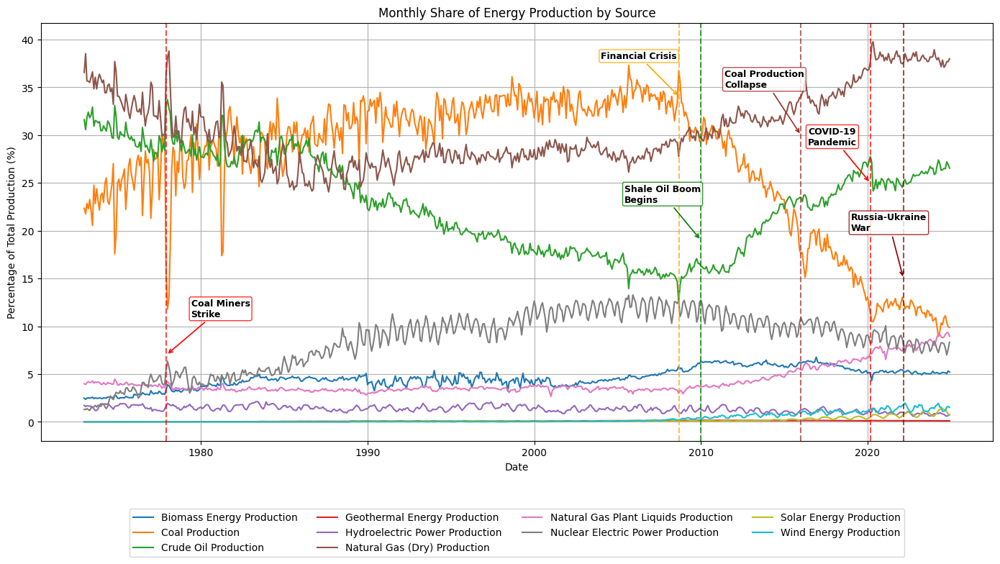

In [4]:
# Pivot the table to have the Date as index and descriptions as columns
pivot_df = clean_df.pivot_table(index='Date', columns='Description', values='Value', aggfunc='sum')

# Calculate the total production for each month
monthly_total = pivot_df.sum(axis=1)

# Normalize the data by dividing each source's value by the monthly total
normalized_df = pivot_df.div(monthly_total, axis=0).multiply(100).fillna(0)

# Visualize the Data as a Line Chart
plt.figure(figsize=(14, 8))
# Plot each column (energy source) as a separate line
for column in normalized_df.columns:
    plt.plot(normalized_df.index, normalized_df[column], label=column)

# Add vertical lines for each event
plt.axvline(x=pd.to_datetime('1977-12-06'), color='red', linestyle='--', alpha=0.7, linewidth=1.5)
plt.axvline(x=pd.to_datetime('2008-09-15'), color='orange', linestyle='--', alpha=0.7, linewidth=1.5)
plt.axvline(x=pd.to_datetime('2010-01-01'), color='green', linestyle='--', alpha=0.7, linewidth=1.5)
plt.axvline(x=pd.to_datetime('2016-01-01'), color='brown', linestyle='--', alpha=0.7, linewidth=1.5)
plt.axvline(x=pd.to_datetime('2020-03-01'), color='red', linestyle='--', alpha=0.7, linewidth=1.5)
plt.axvline(x=pd.to_datetime('2022-02-24'), color='darkred', linestyle='--', alpha=0.7, linewidth=1.5)

# Energy Crisis and Economic Events
plt.annotate('Coal Miners\nStrike',
             xy=(pd.to_datetime('1977-12-06'), 7),
             xytext=(pd.to_datetime('1979-06-01'), 11),
             arrowprops=dict(arrowstyle='->', color='red', lw=1.2),
             fontsize=9, fontweight='bold',
             bbox=dict(boxstyle="round,pad=0.2", facecolor='white', edgecolor='red', alpha=0.8))

plt.annotate('Financial Crisis',
             xy=(pd.to_datetime('2008-09-15'), 34),
             xytext=(pd.to_datetime('2004-01-01'), 38),
             arrowprops=dict(arrowstyle='->', color='orange', lw=1.2),
             fontsize=9, fontweight='bold',
             bbox=dict(boxstyle="round,pad=0.2", facecolor='white', edgecolor='orange', alpha=0.8))

plt.annotate('Shale Oil Boom\nBegins',
             xy=(pd.to_datetime('2010-01-01'), 19),
             xytext=(pd.to_datetime('2005-06-01'), 23),
             arrowprops=dict(arrowstyle='->', color='green', lw=1.2),
             fontsize=9, fontweight='bold',
             bbox=dict(boxstyle="round,pad=0.2", facecolor='white', edgecolor='green', alpha=0.8))

plt.annotate('Coal Production\nCollapse',
             xy=(pd.to_datetime('2016-01-01'), 30),
             xytext=(pd.to_datetime('2011-06-01'), 35),
             arrowprops=dict(arrowstyle='->', color='brown', lw=1.2),
             fontsize=9, fontweight='bold',
             bbox=dict(boxstyle="round,pad=0.2", facecolor='white', edgecolor='brown', alpha=0.8))

plt.annotate('COVID-19\nPandemic',
             xy=(pd.to_datetime('2020-03-01'), 25),
             xytext=(pd.to_datetime('2016-06-01'), 29),
             arrowprops=dict(arrowstyle='->', color='red', lw=1.2),
             fontsize=9, fontweight='bold',
             bbox=dict(boxstyle="round,pad=0.2", facecolor='white', edgecolor='red', alpha=0.8))

plt.annotate('Russia-Ukraine\nWar',
             xy=(pd.to_datetime('2022-02-24'), 15),
             xytext=(pd.to_datetime('2019-01-01'), 20),
             arrowprops=dict(arrowstyle='->', color='darkred', lw=1.2),
             fontsize=9, fontweight='bold',
             bbox=dict(boxstyle="round,pad=0.2", facecolor='white', edgecolor='darkred', alpha=0.8))

# Add title, labels, and Legend outside chart at bottom
plt.title('Monthly Share of Energy Production by Source')
plt.xlabel('Date')
plt.ylabel('Percentage of Total Production (%)')
plt.legend(bbox_to_anchor=(0.5, -0.15), loc='upper center', ncol=4)
plt.grid(True)
plt.tight_layout()

### Geographic Energy Distribution  
*Regional specialization patterns and energy infrastructure mapping*

In [5]:
import pandas as pd

# Reading data directly from the Excel file hosted at EIA website
#excel_file_path = 'https://www.eia.gov/electricity/data/eia860m/archive/xls/may_generator2025.xlsx'
rows_to_skip_at_top = 2
rows_to_skip_at_bottom = 2

# Read the 'Operating' sheet
df_operating = pd.read_excel(
    'data/may_generator2025.xlsx',
    sheet_name='Operating',
    skiprows=rows_to_skip_at_top,
    skipfooter=rows_to_skip_at_bottom
)

In [6]:
# Categorizing the sources by type

technology_map = {
    # Wind
    'Offshore Wind Turbine': 'Wind',
    'Onshore Wind Turbine': 'Wind',

    # Natural Gas
    'Natural Gas Fired Combined Cycle': 'Natural Gas',
    'Natural Gas Fired Combustion Turbine': 'Natural Gas',
    'Natural Gas Internal Combustion Engine': 'Natural Gas',
    'Natural Gas Steam Turbine': 'Natural Gas',
    'Natural Gas with Compressed Air Storage': 'Natural Gas',
    'Other Natural Gas': 'Natural Gas',

    # Nuclear
    'Nuclear': 'Nuclear',

    # Solar
    'Solar Photovoltaic': 'Solar',
    'Solar Thermal with Energy Storage': 'Solar',
    'Solar Thermal without Energy Storage': 'Solar',

    # Coal
    'Coal Integrated Gasification Combined Cycle': 'Coal',
    'Conventional Steam Coal': 'Coal',
    'Petroleum Coke': 'Coal',

    # Conventional Hydroelectric
    'Conventional Hydroelectric': 'Conventional Hydroelectric',

    # Other - These will be mapped explicitly to 'Other'
    'Batteries': 'Other',
    'Flywheels': 'Other',
    'Geothermal': 'Other',
    'Hydroelectric Pumped Storage': 'Other',
    'Landfill Gas': 'Other',
    'Municipal Solid Waste': 'Other',
    'Other Gases': 'Other',
    'Other Waste Biomass': 'Other',
    'Petroleum Liquids': 'Other',
    'Wood/Wood Waste Biomass': 'Other',
    'All Other': 'Other'
}

df_operating['Type'] = df_operating['Technology'].map(technology_map)

In [7]:
# Group data by location and type to sum up the capacity.
df_agg = df_operating.groupby(['Latitude', 'Longitude', 'Type'])['Nameplate Capacity (MW)'].sum().reset_index()

In [8]:
color_map = {
    'Wind': '#67A33D',                        # Green
    'Natural Gas': '#C46215',                 # Light Brown/Orange
    'Nuclear': '#B33A3A',                     # Dark Red
    'Other': '#B3B3B3',                       # Grey
    'Solar': '#FFD700',                       # Yellow
    'Coal': '#6E4700',                        # Dark Brown
    'Conventional Hydroelectric': '#00AEEF'    # Blue
}

In [9]:
import plotly.express as px

fig = px.scatter_mapbox(df_agg,
                        lat="Latitude",
                        lon="Longitude",
                        color="Type",
                        color_discrete_map=color_map,
                        size="Nameplate Capacity (MW)",
                        size_max=10,
                        zoom=3,
                        mapbox_style="open-street-map",
                        hover_name="Type",
                        hover_data={"Nameplate Capacity (MW)": ":.2f MW", "Latitude":False, "Longitude":False}
                       )
# Update layout for better legend organization
fig.update_layout(
    title="Power Plant Locations by Type and Capacity",
    title_x=0.5,
    height=600,
    legend=dict(
        orientation="v",
        yanchor="top",
        y=1,
        xanchor="left",
        x=1.02,
        itemsizing="constant",
        groupclick="toggleitem"
    )
)
fig.show()

C:\Users\murun\AppData\Local\Temp\ipykernel_18084\850226137.py:3: DeprecationWarning: *scatter_mapbox* is deprecated! Use *scatter_map* instead. Learn more at: https://plotly.com/python/mapbox-to-maplibre/
  fig = px.scatter_mapbox(df_agg,


In [10]:
import folium

# Group data by location and type to sum up the capacity.
df_agg = df_operating.groupby(['Latitude', 'Longitude', 'Type'])['Nameplate Capacity (MW)'].sum().reset_index()

color_map = {
    'Wind': '#67A33D',                        # Green
    'Natural Gas': '#C46215',                 # Light Brown/Orange
    'Nuclear': '#B33A3A',                     # Dark Red
    'Other': '#B3B3B3',                       # Grey
    'Solar': '#FFD700',                       # Yellow
    'Coal': '#6E4700',                        # Dark Brown
    'Conventional Hydroelectric': '#00AEEF'    # Blue
}

# Center the map on the continental United States
us_center = (39.8283, -98.5795)
m = folium.Map(location=us_center, zoom_start=4, tiles="OpenStreetMap")

max_capacity = max(df_agg['Nameplate Capacity (MW)'])
min_capacity = min(df_agg['Nameplate Capacity (MW)'])

# We will iterate through our aggregated data to create a circle marker for each point.
for index, row in df_agg.iterrows():
    lat = row['Latitude']
    lon = row['Longitude']
    capacity = row['Nameplate Capacity (MW)']
    plant_type = row['Type']

    # Scale marker radius based on capacity
    radius = (capacity / (max_capacity/10))

    # Create a popup message with formatted HTML for when a marker is clicked
    popup_html = f"""
    <b>Type:</b> {plant_type}<br>
    <b>Total Capacity:</b> {capacity:.2f} MW<br>
    <b>Location:</b> ({lat:.4f}, {lon:.4f})
    """
    popup = folium.Popup(popup_html, max_width=300)

    # Create the circle marker
    folium.CircleMarker(
        location=(lat, lon),
        radius=radius,
        popup=popup,
        color=color_map.get(plant_type, '#A9A9A9'), # Default to gray if type not in map
        fill=True,
        fill_color=color_map.get(plant_type, '#A9A9A9'),
        fill_opacity=0.7
    ).add_to(m)

# Create capacity ranges for the size legend
capacity_ranges = [
    (min_capacity, max_capacity * 0.25),
    (max_capacity * 0.25, max_capacity * 0.5),
    (max_capacity * 0.5, max_capacity * 0.75),
    (max_capacity * 0.75, max_capacity)
]

# Calculate corresponding radius values for legend
legend_radii = [(cap_range[1] / (max_capacity/10)) for cap_range in capacity_ranges]

# The HTML for the legend has been updated to match specific types.
plant_type_legend_html = '''
     <div style="position: fixed;
     bottom: 20px; left: 20px; width: 200px; height: 175px;
     border:2px solid grey; z-index:9999; font-size:14px;
     background-color:white;
     ">&nbsp; <b>Plant Type</b> <br>
     &nbsp; Solar &nbsp; <i class="fa fa-circle" style="color:#FFD700"></i><br>
     &nbsp; Natural Gas &nbsp; <i class="fa fa-circle" style="color:#C46215"></i><br>
     &nbsp; Wind &nbsp; <i class="fa fa-circle" style="color:#67A33D"></i><br>
     &nbsp; Nuclear &nbsp; <i class="fa fa-circle" style="color:#B33A3A"></i><br>
     &nbsp; Conventional Hydro &nbsp; <i class="fa fa-circle" style="color:#00AEEF"></i><br>
     &nbsp; Coal &nbsp; <i class="fa fa-circle" style="color:#6E4700"></i><br>
     &nbsp; Other &nbsp; <i class="fa fa-circle" style="color:#B3B3B3"></i><br>
      </div>
     '''

# The HTML for the marker size legend
size_legend_html = f'''
     <div style="position: fixed;
     bottom: 20px; right: 20px; width: 170px; height: 200px;
     border:2px solid grey; z-index:9999; font-size:14px;
     background-color:white; padding: 10px;
     ">&nbsp; <b>Capacity (MW)</b> <br><br>
     &nbsp; <svg width="20" height="20"><circle cx="10" cy="10" r="{legend_radii[0]:.1f}" fill="#666" opacity="0.7"></circle></svg>
     &nbsp; {capacity_ranges[0][0]:.0f} - {capacity_ranges[0][1]:.0f} MW<br><br>
     &nbsp; <svg width="20" height="20"><circle cx="10" cy="10" r="{legend_radii[1]:.1f}" fill="#666" opacity="0.7"></circle></svg>
     &nbsp; {capacity_ranges[1][0]:.0f} - {capacity_ranges[1][1]:.0f} MW<br><br>
     &nbsp; <svg width="20" height="20"><circle cx="10" cy="10" r="{legend_radii[2]:.1f}" fill="#666" opacity="0.7"></circle></svg>
     &nbsp; {capacity_ranges[2][0]:.0f} - {capacity_ranges[2][1]:.0f} MW<br><br>
     &nbsp; <svg width="20" height="20"><circle cx="10" cy="10" r="{legend_radii[3]:.1f}" fill="#666" opacity="0.7"></circle></svg>
     &nbsp; {capacity_ranges[3][0]:.0f} - {capacity_ranges[3][1]:.0f} MW<br>
      </div>
     '''

# Add both legends to the map
m.get_root().html.add_child(folium.Element(plant_type_legend_html))
m.get_root().html.add_child(folium.Element(size_legend_html))

# Display map in a notebook
m

In [11]:
# Regional encodings
REGION_ENCODINGS = {
    'East': ['CT', 'DE', 'ME', 'MD', 'MA', 'NH', 'NJ', 'NY', 'PA', 'RI', 'VT'],
    'Midwest': ['IL', 'IN', 'IA', 'KS', 'MI', 'MN', 'MO', 'NE', 'ND', 'OH', 'SD', 'WI'],
    'South': ['AL', 'AR', 'FL', 'GA', 'KY', 'LA', 'MS', 'NC', 'SC', 'TN', 'VA', 'WV'],
    'Southwest': ['AZ', 'NM', 'OK', 'TX'],
    'West': ['CA', 'CO', 'ID', 'MT', 'NV', 'OR', 'UT', 'WA', 'WY'],
    'Noncontiguous': ['HI', 'AK']
}

# Dictionary for mapping state code to region name
state_to_region_map = {
    state: region
    for region, states in REGION_ENCODINGS.items()
    for state in states
}

df_operating['Region'] = df_operating['Plant State'].map(state_to_region_map)

In [12]:
import plotly.express as px

color_map = {
    'Wind': '#67A33D',                        # Green
    'Natural Gas': '#C46215',                 # Light Brown/Orange
    'Nuclear': '#B33A3A',                     # Dark Red
    'Other': '#B3B3B3',                       # Grey
    'Solar': '#FFD700',                       # Yellow
    'Coal': '#6E4700',                        # Dark Brown
    'Conventional Hydroelectric': '#00AEEF'    # Blue
}


# Group by state and energy type, then sum the total capacity for each.
state_energy_capacity = df_operating.groupby(
    ['Plant State', 'Type']
)['Nameplate Capacity (MW)'].sum().reset_index()

# For each state, find the row with the maximum capacity.
dominant_source_idx = state_energy_capacity.groupby('Plant State')['Nameplate Capacity (MW)'].idxmax()
dominant_source_df = state_energy_capacity.loc[dominant_source_idx]

# Create the choropleth figure using Plotly Express.
fig = px.choropleth(
    dominant_source_df,
    locations='Plant State',             # Column with state abbreviations (e.g., 'CA', 'TX')
    locationmode="USA-states",           # Set the map type to US states
    color='Type',                        # Column to determine the color of each state
    scope="usa",                         # Focus the map on the USA
    color_discrete_map=color_map,        # Apply your custom color scheme
    title="Dominant Energy Production Source by State (Based on Nameplate Capacity)",
    hover_name='Plant State',            # What to display when hovering over a state
    hover_data={                         # Additional data to show on hover
        'Type': True,
        'Nameplate Capacity (MW)': ':.2f', # Show capacity with 2 decimal places
        'Plant State': False # Hide the redundant state abbreviation in the hover box
    }
)

# Customize the legend and layout for a cleaner look.
fig.update_layout(
    legend_title_text='Energy Source',
    legend=dict(
        x=1.05,
        y=1,
        xanchor='left',
        yanchor='top'
    ),
    margin={"r":0,"t":50,"l":0,"b":0} # Adjust margins
)

# Display the interactive map.
fig.show()

In [13]:
# Quantitative Analysis

df_agg_region = df_operating.groupby(['Region', 'Type'])['Nameplate Capacity (MW)'].sum().reset_index()

# 1. Fossil Fuel Concentration Analysis
print("--- Fossil Fuel Concentration Analysis ---")
# Filter for Coal and Natural Gas
fossil_fuels_df = df_agg_region[df_agg_region['Type'].isin(['Coal', 'Natural Gas'])]
# Calculate total fossil fuel capacity nationwide
total_fossil_fuel_capacity = fossil_fuels_df['Nameplate Capacity (MW)'].sum()
# Calculate capacity in the specified eastern regions
eastern_regions_ff_capacity = fossil_fuels_df[fossil_fuels_df['Region'].isin(['East', 'Midwest', 'South'])]['Nameplate Capacity (MW)'].sum()
# Calculate the percentage
percentage_ff_in_east = (eastern_regions_ff_capacity / total_fossil_fuel_capacity) * 100
print(f"Total Fossil Fuel Capacity: {total_fossil_fuel_capacity:,.2f} MW")
print(f"East, Midwest, & South Fossil Fuel Capacity: {eastern_regions_ff_capacity:,.2f} MW")
print(f"Percentage in Eastern Regions: {percentage_ff_in_east:.2f}%\n")


# 2. Renewable Corridors: Wind Analysis
print("--- Wind Corridor Analysis ---")
# Filter for Wind
wind_df = df_agg_region[df_agg_region['Type'] == 'Wind']
# Calculate total wind capacity nationwide
total_wind_capacity = wind_df['Nameplate Capacity (MW)'].sum()
# Calculate capacity in the Midwest and Southwest corridor
wind_corridor_capacity = wind_df[wind_df['Region'].isin(['Midwest', 'Southwest'])]['Nameplate Capacity (MW)'].sum()
# Calculate the percentage
percentage_wind_in_corridor = (wind_corridor_capacity / total_wind_capacity) * 100
print(f"Total Wind Capacity: {total_wind_capacity:,.2f} MW")
print(f"Midwest & Southwest Wind Capacity: {wind_corridor_capacity:,.2f} MW")
print(f"Percentage in Wind Corridor: {percentage_wind_in_corridor:.2f}%\n")


# 3. Renewable Corridors: Solar Analysis
print("--- Solar Belt Analysis ---")
# Filter for Solar
solar_df = df_agg_region[df_agg_region['Type'] == 'Solar']
# Calculate total solar capacity nationwide
total_solar_capacity = solar_df['Nameplate Capacity (MW)'].sum()
# Calculate capacity in the South, Southwest, and West belt
solar_belt_capacity = solar_df[solar_df['Region'].isin(['South', 'Southwest', 'West'])]['Nameplate Capacity (MW)'].sum()
# Calculate the percentage
percentage_solar_in_belt = (solar_belt_capacity / total_solar_capacity) * 100
print(f"Total Solar Capacity: {total_solar_capacity:,.2f} MW")
print(f"South, Southwest, & West Solar Capacity: {solar_belt_capacity:,.2f} MW")
print(f"Percentage in Solar Belt: {percentage_solar_in_belt:.2f}%\n")


# 4. Hydroelectric Dominance Analysis
print("--- Hydroelectric Dominance Analysis ---")
# Filter for Conventional Hydroelectric
hydro_df = df_agg_region[df_agg_region['Type'] == 'Conventional Hydroelectric']
# Calculate total hydro capacity nationwide
total_hydro_capacity = hydro_df['Nameplate Capacity (MW)'].sum()
# Calculate capacity in the West
west_hydro_capacity = hydro_df[hydro_df['Region'] == 'West']['Nameplate Capacity (MW)'].sum()
# Calculate the percentage
percentage_hydro_in_west = (west_hydro_capacity / total_hydro_capacity) * 100
print(f"Total Hydroelectric Capacity: {total_hydro_capacity:,.2f} MW")
print(f"West Hydroelectric Capacity: {west_hydro_capacity:,.2f} MW")
print(f"Percentage in West: {percentage_hydro_in_west:.2f}%\n")

--- Fossil Fuel Concentration Analysis ---
Total Fossil Fuel Capacity: 761,472.70 MW
East, Midwest, & South Fossil Fuel Capacity: 524,912.50 MW
Percentage in Eastern Regions: 68.93%

--- Wind Corridor Analysis ---
Total Wind Capacity: 155,637.50 MW
Midwest & Southwest Wind Capacity: 120,549.80 MW
Percentage in Wind Corridor: 77.46%

--- Solar Belt Analysis ---
Total Solar Capacity: 134,343.20 MW
South, Southwest, & West Solar Capacity: 106,899.30 MW
Percentage in Solar Belt: 79.57%

--- Hydroelectric Dominance Analysis ---
Total Hydroelectric Capacity: 79,982.50 MW
West Hydroelectric Capacity: 47,460.50 MW
Percentage in West: 59.34%



### Energy Flow Analysis
*Interstate energy trade patterns and surplus/deficit relationships*

In [14]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px

In [15]:
state_generation_df: pd.DataFrame  = pd.read_excel('data/State_Net_Generation_2023.xlsx')
state_generation_df['State'] = state_generation_df['State'].astype('category')

state_generation_df.head()

,State,Net Generation,Region
0,AK,0.0,NONCONTINGUOUS_STATES
1,AL,-404.8,SOUTH_STATES
2,AR,-101.2,SOUTH_STATES
3,AZ,-186.1,SOUTHWEST_STATES
4,CA,371.7,WEST_STATES


In [16]:
# draw energy import/export choropleth map
fig = px.choropleth(
    state_generation_df,
    locations="State",
    locationmode="USA-states",
    scope="usa",
    color="Net Generation",
    color_continuous_scale="RdBu",  # or 'oxy'
    color_continuous_midpoint=0,
    title="US States Energy Generation",
    labels={"Net Generation": "Net Generation (Trillion Btu)"},
)

fig.show()

In [17]:
# regional net electricity generation sums
EAST_generation = state_generation_df.loc[state_generation_df['Region'] == 'EAST_STATES', 'Net Generation'].sum()
MIDWEST_generation = state_generation_df.loc[state_generation_df['Region'] == 'MIDWEST_STATES', 'Net Generation'].sum()
SOUTH_generation = state_generation_df.loc[state_generation_df['Region'] == 'SOUTH_STATES', 'Net Generation'].sum()
SOUTHWEST_generation = state_generation_df.loc[state_generation_df['Region'] == 'SOUTHWEST_STATES', 'Net Generation'].sum()
WEST_generation = state_generation_df.loc[state_generation_df['Region'] == 'WEST_STATES', 'Net Generation'].sum()
NONCONTINGUOUS_generation = state_generation_df.loc[state_generation_df['Region'] == 'NONCONTINGUOUS_STATES', 'Net Generation'].sum()

# add new column to hold region generation
state_generation_df['Region Generation'] = np.nan

state_generation_df.head()

,State,Net Generation,Region,Region Generation
0,AK,0.0,NONCONTINGUOUS_STATES,NaN
1,AL,-404.8,SOUTH_STATES,NaN
2,AR,-101.2,SOUTH_STATES,NaN
3,AZ,-186.1,SOUTHWEST_STATES,NaN
4,CA,371.7,WEST_STATES,NaN


In [18]:
# add the sums to the correct region
state_generation_df.loc[state_generation_df['Region'] == 'EAST_STATES', 'Region Generation'] = EAST_generation
state_generation_df.loc[state_generation_df['Region'] == 'MIDWEST_STATES', 'Region Generation'] = MIDWEST_generation
state_generation_df.loc[state_generation_df['Region'] == 'SOUTH_STATES', 'Region Generation'] = SOUTH_generation
state_generation_df.loc[state_generation_df['Region'] == 'SOUTHWEST_STATES', 'Region Generation'] = SOUTHWEST_generation
state_generation_df.loc[state_generation_df['Region'] == 'WEST_STATES', 'Region Generation'] = WEST_generation
state_generation_df.loc[state_generation_df['Region'] == 'NONCONTINGUOUS_STATES', 'Region Generation'] = NONCONTINGUOUS_generation

state_generation_df.head()

,State,Net Generation,Region,Region Generation
0,AK,0.0,NONCONTINGUOUS_STATES,0.0
1,AL,-404.8,SOUTH_STATES,345.7
2,AR,-101.2,SOUTH_STATES,345.7
3,AZ,-186.1,SOUTHWEST_STATES,-274.8
4,CA,371.7,WEST_STATES,171.6


In [19]:
fig = px.choropleth(
    state_generation_df,
    locations="State",
    locationmode="USA-states",
    scope="usa",
    color="Region Generation",
    color_continuous_scale="RdBu",  # or 'oxy' RdBu
    color_continuous_midpoint=0,
    title="US Region Energy Generation",
)
fig.show()

C:\Users\murun\AppData\Local\Temp\ipykernel_18084\2045059981.py:18: UserWarning:

set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.



Text(0, 0.5, 'Net Generation (Trillion Btu)')

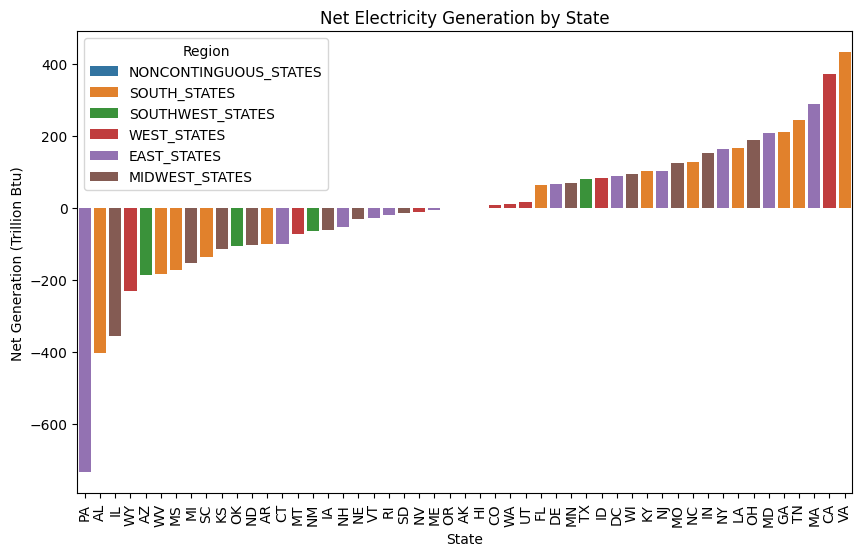

In [20]:
fig, ax = plt.subplots(figsize=(10, 6))

# sort the 'State' by their 'Net Generation'
sorted_categories = state_generation_df.sort_values(
    by="Net Generation", ascending=True
)["State"].tolist()

sns.barplot(
    data=state_generation_df,
    x="State",
    y="Net Generation",
    hue="Region",
    order=sorted_categories,
    ax=ax,
)

ax.set_title("Net Electricity Generation by State")
ax.set_xticklabels(ax.get_xticklabels(), rotation=90, fontsize=10)
ax.set_ylabel("Net Generation (Trillion Btu)")

In [21]:
state_type_df  = pd.read_excel('data/State_Energy_Type_Generated_2023.xlsx')

# drop Biofuel because it's all 0s
state_type_df = state_type_df.drop([4])

state_type_df['Type'] = state_type_df['Type'].astype('category')

In [22]:
STATE_ENCODINGS: dict[str, str] = {
    "AL": "Alabama",
    "AK": "Alaska",
    "AZ": "Arizona",
    "AR": "Arkansas",
    "CA": "California",
    "CO": "Colorado",
    "CT": "Connecticut",
    "DE": "Delaware",
    "FL": "Florida",
    "GA": "Georgia",
    "HI": "Hawaii",
    "ID": "Idaho",
    "IL": "Illinois",
    "IN": "Indiana",
    "IA": "Iowa",
    "KS": "Kansas",
    "KY": "Kentucky",
    "LA": "Louisiana",
    "ME": "Maine",
    "MD": "Maryland",
    "MA": "Massachusetts",
    "MI": "Michigan",
    "MN": "Minnesota",
    "MS": "Mississippi",
    "MO": "Missouri",
    "MT": "Montana",
    "NE": "Nebraska",
    "NV": "Nevada",
    "NH": "New Hampshire",
    "NJ": "New Jersey",
    "NM": "New Mexico",
    "NY": "New York",
    "NC": "North Carolina",
    "ND": "North Dakota",
    "OH": "Ohio",
    "OK": "Oklahoma",
    "OR": "Oregon",
    "PA": "Pennsylvania",
    "RI": "Rhode Island",
    "SC": "South Carolina",
    "SD": "South Dakota",
    "TN": "Tennessee",
    "TX": "Texas",
    "UT": "Utah",
    "VT": "Vermont",
    "VA": "Virginia",
    "WA": "Washington",
    "WV": "West Virginia",
    "WI": "Wisconsin",
    "WY": "Wyoming",
    # "DC": "District of Columbia"
}

In [23]:
encoding_list_tempt = [(v, k) for k, v in STATE_ENCODINGS.items()]

In [24]:
STATE_NAMES = dict(encoding_list_tempt)

#### State Energy Rank
Source: https://www.eia.gov/state/
Each state manually tabularized into Excel [AK-WY]

In [25]:
state_type_df: pd.DataFrame = pd.read_excel("data/State_Energy_Type_Generated_2023.xlsx")

# drop Biofuel because it's all 0s
state_type_df = state_type_df.drop([4])

state_type_df["Type"] = state_type_df["Type"].astype("category")

state_type_df.head()

,Type,Alaska,Alabama,Arkansas,Arizona,California,Colorado,Connecticut,Delaware,Florida,...,South Dakota,Tennessee,Texas,Utah,Virginia,Vermont,Washington,Wisconsin,West Virginia,Wyoming
0,Coal,15.5,303.5,0.0,0.0,0.0,256.2,0.0,0.0,0.0,...,0.0,0.0,182.2,156.6,282.8,0.0,0.0,0.0,2201.8,4133.0
1,Natural Gas - Marketed,410.7,92.5,399.1,0.0,148.9,2245.8,0.0,0.0,0.7,...,0.1,3.1,14311.7,318.5,87.6,0.0,0.0,0.0,3762.9,1105.4
2,Crude Oil,884.4,20.4,25.3,0.0,673.2,948.9,0.0,0.0,5.8,...,5.2,1.0,11443.5,321.1,0.0,0.0,0.0,0.0,105.6,551.0
3,Nuclear Electric Power,0.0,476.4,156.5,329.5,185.2,0.0,142.9,0.0,312.9,...,0.0,396.5,425.2,0.0,310.0,0.0,88.2,101.2,0.0,0.0
5,Wood and Waste,3.4,168.6,66.4,9.7,114.6,9.3,23.0,1.7,112.9,...,3.4,44.0,98.5,5.6,125.8,11.6,90.7,76.2,7.0,1.8


In [26]:
state_type_df = pd.melt(
    state_type_df,
    id_vars=["Type"],
    value_vars=list(state_type_df.columns),
    var_name="State",
    value_name="Generated",
)
state_type_df["State"] = state_type_df["State"].astype("category")

In [27]:
state_type_df.head(10)

,Type,State,Generated
0,Coal,Alaska,15.5
1,Natural Gas - Marketed,Alaska,410.7
2,Crude Oil,Alaska,884.4
3,Nuclear Electric Power,Alaska,0.0
4,Wood and Waste,Alaska,3.4
5,Noncombustible Renewables,Alaska,6.7
6,Coal,Alabama,303.5
7,Natural Gas - Marketed,Alabama,92.5
8,Crude Oil,Alabama,20.4
9,Nuclear Electric Power,Alabama,476.4


In [28]:
state_total_df = state_type_df.pivot(
    index='State',
    columns='Type',
    values='Generated'
)

state_total_df

Type,Coal,Crude Oil,Natural Gas - Marketed,Noncombustible Renewables,Nuclear Electric Power,Wood and Waste
State,,,,,,
Alabama,303.5,20.4,92.5,33.1,476.4,168.6
Alaska,15.5,884.4,410.7,6.7,0.0,3.4
Arizona,0.0,0.0,0.0,71.9,329.5,9.7
Arkansas,0.0,25.3,399.1,16.0,156.5,66.4
California,0.0,673.2,148.9,452.6,185.2,114.6
Colorado,256.2,948.9,2245.8,79.5,0.0,9.3
Connecticut,0.0,0.0,0.0,8.3,142.9,23.0
Delaware,0.0,0.0,0.0,1.7,0.0,1.7
Florida,0.0,5.8,0.7,99.0,312.9,112.9


In [29]:
state_total_df['Total'] = state_total_df[
    [
        "Coal",
        "Crude Oil",
        "Natural Gas - Marketed",
        "Noncombustible Renewables",
        "Nuclear Electric Power",
        "Wood and Waste",
    ]
].sum(axis=1)

In [30]:
state_total_df = state_total_df['Total']
state_total_df = state_total_df.reset_index()
state_total_df.head(10)

,State,Total
0,Alabama,1094.5
1,Alaska,1320.7
2,Arizona,411.1
3,Arkansas,663.3
4,California,1574.5
5,Colorado,3539.7
6,Connecticut,174.2
7,Delaware,3.4
8,Florida,531.3
9,Georgia,660.7


In [31]:
# turn state names to state codes, sort
state_total_df['State'] = state_total_df['State'].cat.rename_categories(STATE_NAMES)
state_total_df = state_total_df.sort_values(by='State', key=lambda x: x.str.lower())
state_total_df.head(10)

,State,Total
1,AK,1320.7
0,AL,1094.5
3,AR,663.3
2,AZ,411.1
4,CA,1574.5
5,CO,3539.7
6,CT,174.2
7,DE,3.4
8,FL,531.3
9,GA,660.7


In [32]:
# remove DC
state_generation_df = state_generation_df[state_generation_df['State'] != 'DC']
state_generation_df = state_generation_df.reset_index(drop=True)
state_generation_df.head()

,State,Net Generation,Region,Region Generation
0,AK,0.0,NONCONTINGUOUS_STATES,0.0
1,AL,-404.8,SOUTH_STATES,345.7
2,AR,-101.2,SOUTH_STATES,345.7
3,AZ,-186.1,SOUTHWEST_STATES,-274.8
4,CA,371.7,WEST_STATES,171.6


In [33]:
state_all_info = state_generation_df.merge(state_total_df, how='left', on='State')
state_all_info.head()

,State,Net Generation,Region,Region Generation,Total
0,AK,0.0,NONCONTINGUOUS_STATES,0.0,1320.7
1,AL,-404.8,SOUTH_STATES,345.7,1094.5
2,AR,-101.2,SOUTH_STATES,345.7,663.3
3,AZ,-186.1,SOUTHWEST_STATES,-274.8,411.1
4,CA,371.7,WEST_STATES,171.6,1574.5


In [34]:
# calculate the Pareto cutoff (top states that produce 80% of total energy)
state_pareto_df = state_total_df.sort_values(by='Total', ascending=False)
state_pareto_df['cumulative_percentage'] = (state_pareto_df['Total'].cumsum() / state_pareto_df['Total'].sum()) * 100
top_pareto = state_pareto_df[state_pareto_df['cumulative_percentage'] < 80]
top_pareto

,State,Total,cumulative_percentage
42,TX,26986.0,28.343513
37,PA,10078.3,38.928795
30,NM,7638.0,46.951019
47,WV,6089.9,53.347267
49,WY,5825.2,59.465500
17,LA,4874.7,64.585419
33,ND,4389.5,69.195729
35,OK,4377.2,73.793122
5,CO,3539.7,77.510884


#### Pareto cutoff is Colorado (CO)

C:\Users\murun\AppData\Local\Temp\ipykernel_18084\2671206485.py:25: UserWarning:

set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.



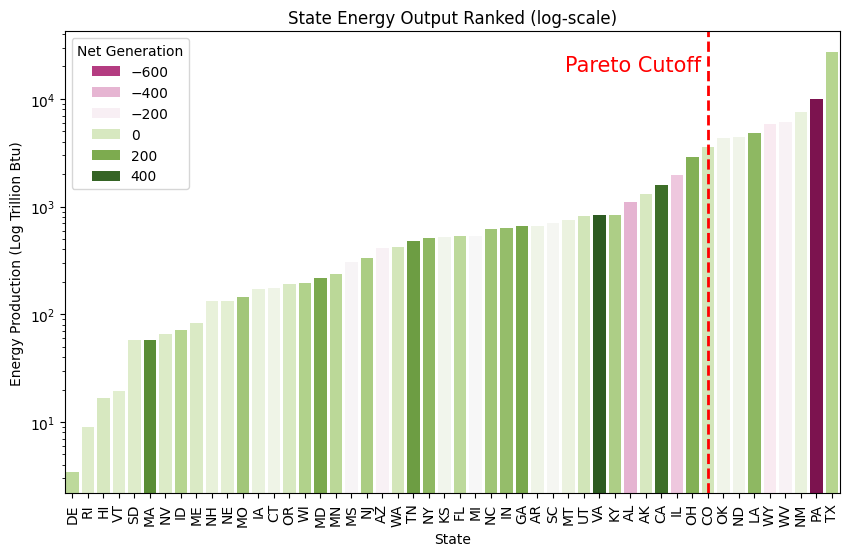

In [35]:
fig, ax = plt.subplots(figsize=(10, 6))

# sort the 'State' by their 'Total'
sorted_categories = state_all_info.sort_values(
    by="Total", ascending=True
)["State"].tolist()

sns.barplot(
    data=state_all_info,
    x="State",
    y="Total",
    hue="Net Generation",
    palette="PiYG",
    order=sorted_categories,
    ax=ax,
)

# add Pareto cutoff
plt.axvline(x=top_pareto['State'].iloc[-1], color='red', linestyle='--', linewidth=2)
plt.text(plt.xlim()[1] * 0.82, plt.ylim()[1] * 0.9, 'Pareto Cutoff', color='red', ha='right', va='top', fontsize= 15)

plt.yscale('log')

ax.set_title("State Energy Output Ranked (log-scale)")
ax.set_xticklabels(ax.get_xticklabels(), rotation=90, fontsize=10);
ax.set_ylabel("Energy Production (Log Trillion Btu)");

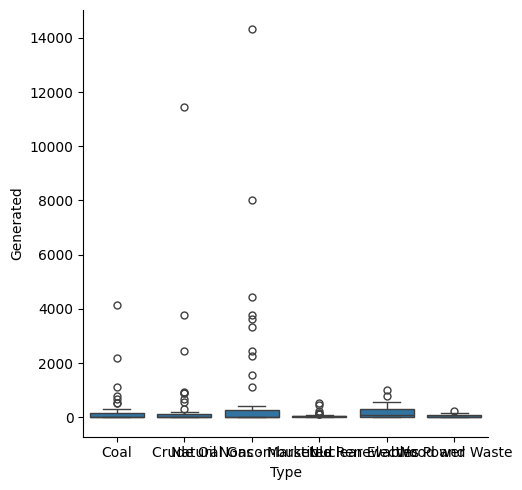

In [36]:
# sns.catplot(data=state_type_df, x="Type", y="Generated", kind="violin")
sns.catplot(
    data=state_type_df,
    x="Type",
    y="Generated",
    kind="box",
)

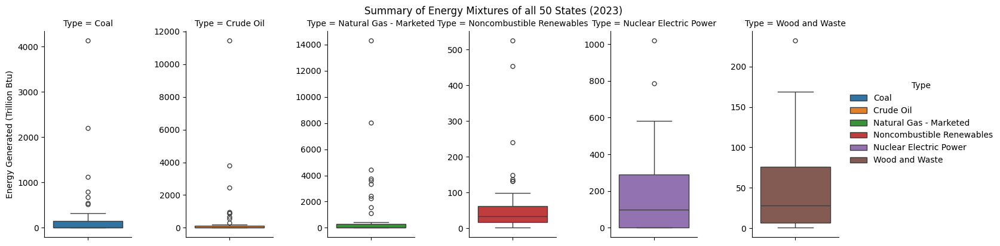

In [37]:
g = sns.catplot(
    data=state_type_df,
    x=None,
    y="Generated",
    col="Type",
    kind="box",
    sharey=False,
    height=4,
    aspect=0.6,
    hue="Type",
)

g.set_axis_labels(y_var="Energy Generated (Trillion Btu)")
g.figure.suptitle("Summary of Energy Mixtures of all 50 States (2023)", y=1.02)

# g.set_titles("{Type}")

plt.show()

### State Fuel Mixture Breakdown
*Detailed analysis of state-level energy source portfolios*

In [38]:
column_order: list[str] = [
    "Wood and Waste",
    "Noncombustible Renewables",
    "Nuclear Electric Power",
    "Coal",
    "Crude Oil",
    "Natural Gas - Marketed",
    "TotalSum",
]

In [39]:
state_type_wide: pd.DataFrame = state_type_df.pivot(
    index="State", columns="Type", values="Generated"
)

state_type_wide = state_type_wide.reset_index()  # reintroduce normal index

# create a sum energy total per state as new column
state_type_wide["TotalSum"] = state_type_wide[
    [
        "Coal",
        "Natural Gas - Marketed",
        "Crude Oil",
        "Nuclear Electric Power",
        "Wood and Waste",
        "Noncombustible Renewables",
    ]
].sum(axis=1)

# force category ordering
state_type_wide_sorted = state_type_wide.sort_values("TotalSum", ascending=False)
state_order = state_type_wide_sorted["State"].tolist()
state_type_wide_sorted["State"] = pd.Categorical(
    state_type_wide_sorted["State"], categories=state_order, ordered=True
)

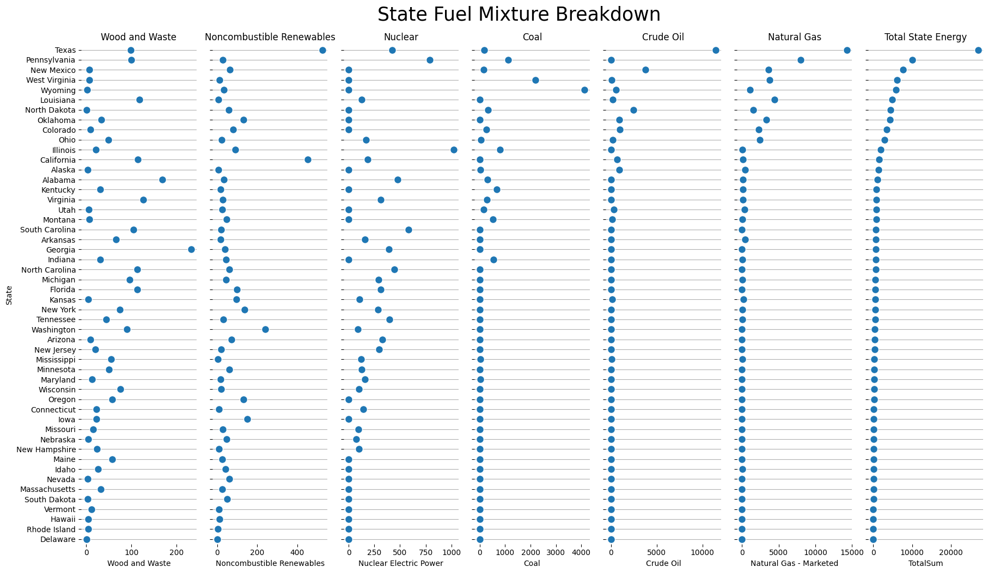

In [40]:
g = sns.PairGrid(
    state_type_wide_sorted,
    x_vars=column_order,
    y_vars="State",
    height=10,
    aspect=0.25,
)

g.map(
    sns.stripplot,
    size=10,
    orient="h",
    jitter=False,
    # palette='flare_r',
    linewidth=1,
    edgecolor="w",
)

g.figure.suptitle('State Fuel Mixture Breakdown', y=1.05, fontsize=25)
g.add_legend()

titles = [
    "Wood and Waste",
    "Noncombustible Renewables",
    "Nuclear",
    "Coal",
    "Crude Oil",
    "Natural Gas",
    "Total State Energy",
]

for ax, title in zip(g.axes.flat, titles):

    ax.set(title=title)

    ax.xaxis.grid(False)
    ax.yaxis.grid(True)

sns.despine(left=True, bottom=True)

#### State Fuel Mixture by Political Leaning

In [41]:
red_states: pd.DataFrame = pd.DataFrame(
    {
        "State": [
            "Alabama",
            "Alaska",
            "Arizona",
            "Arkansas",
            "Colorado",
            "Florida",
            "Georgia",
            "Idaho",
            "Indiana",
            "Iowa",
            "Kansas",
            "Kentucky",
            "Louisiana",
            "Michigan",
            "Mississippi",
            "Missouri",
            "Montana",
            "Nebraska",
            "Nevada",
            "North Carolina",
            "North Dakota",
            "Ohio",
            "Oklahoma",
            "Pennsylvania",
            "South Carolina",
            "South Dakota",
            "Tennessee",
            "Texas",
            "Utah",
            "Virginia",
            "West Virginia",
            "Wisconsin",
            "Wyoming",
        ],
        "leaning": "red",
    }
)

blue_states: pd.DataFrame = pd.DataFrame(
    {
        "State": [
            "California",
            "Connecticut",
            "Delaware",
            "Hawaii",
            "Illinois",
            "Maine",
            "Maryland",
            "Massachusetts",
            "Minnesota",
            "New Hampshire",
            "New Jersey",
            "New Mexico",
            "New York",
            "Oregon",
            "Rhode Island",
            "Vermont",
            "Washington",
        ],
        "leaning": "blue",
    }
)

In [42]:
state_leanings: pd.DataFrame = pd.concat([red_states, blue_states])

In [43]:
state_leanings = state_leanings.sort_values(by='State')
state_leanings = state_leanings.reset_index(drop=True) # reintroduce normal index

In [44]:
state_type_wide: pd.DataFrame = state_type_df.pivot(
    index='State',
    columns='Type',
    values='Generated'
)

state_type_wide = state_type_wide.reset_index() # reintroduce normal index

# join the state generation into fuel mixture
state_type_wide = pd.merge(state_type_wide, state_leanings[['State', 'leaning']], on='State', how='left')

# create a sum energy total per state as new column
state_type_wide['TotalSum'] = state_type_wide[
    ['Coal', 'Natural Gas - Marketed', 'Crude Oil', 'Nuclear Electric Power', 'Wood and Waste', 'Noncombustible Renewables']
].sum(axis=1)

# force category ordering
state_type_wide_sorted = state_type_wide.sort_values('TotalSum', ascending=False)
state_order = state_type_wide_sorted['State'].tolist()
state_type_wide_sorted['State'] = pd.Categorical(state_type_wide_sorted['State'], categories=state_order, ordered=True)

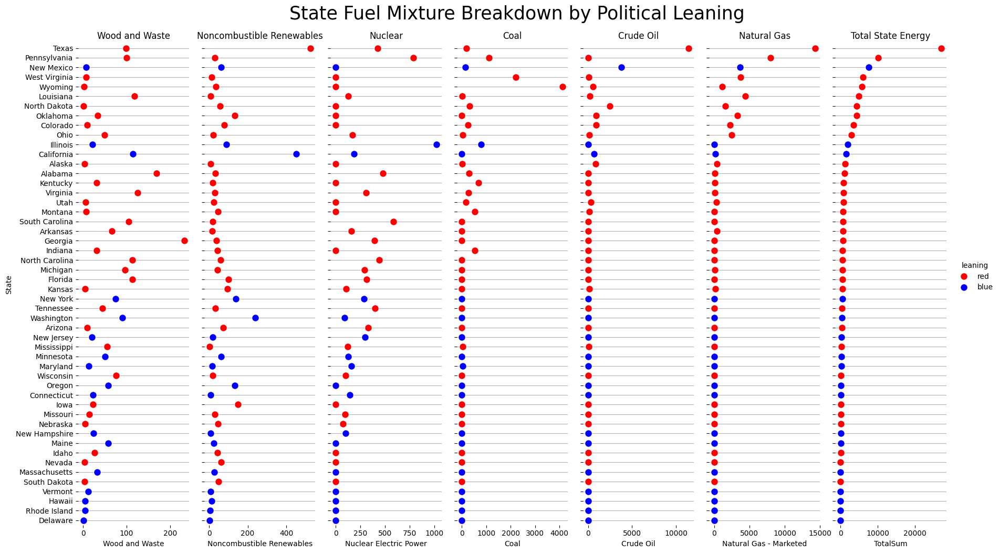

In [45]:
g = sns.PairGrid(
    state_type_wide_sorted,
    x_vars=column_order,
    y_vars="State",
    height=10,
    aspect=0.25,
    hue="leaning",
    palette=['red', 'blue']#"PiYG", # bwr_r
)


g.map(
    sns.stripplot,
    size=10,
    orient="h",
    jitter=False,
    # palette='flare_r',
    linewidth=1,
    edgecolor="w",
)

g.figure.suptitle('State Fuel Mixture Breakdown by Political Leaning', y=1.05, fontsize=25)
g.add_legend()


titles = [
    "Wood and Waste",
    "Noncombustible Renewables",
    "Nuclear",
    "Coal",
    "Crude Oil",
    "Natural Gas",
    "Total State Energy",
]

for ax, title in zip(g.axes.flat, titles):

    ax.set(title=title)

    ax.xaxis.grid(False)
    ax.yaxis.grid(True)

sns.despine(left=True, bottom=True)

#### State Fuel Mixture by Net Generation

In [46]:
state_gen_copy: pd.DataFrame = state_generation_df.drop(['Region', 'Region Generation'], axis=1)

In [47]:
# go from state encoding to state names
state_gen_copy['State'] = state_gen_copy['State'].cat.rename_categories(STATE_ENCODINGS)
state_gen_copy = state_gen_copy.sort_values(by='State')

In [48]:
# join the state generation into fuel mixture
state_type_wide = pd.merge(state_type_wide, state_gen_copy[['State', 'Net Generation']], on='State', how='left')

# force category ordering
state_type_wide_sorted = state_type_wide.sort_values('TotalSum', ascending=False)
state_order = state_type_wide_sorted['State'].tolist()
state_type_wide_sorted['State'] = pd.Categorical(state_type_wide_sorted['State'], categories=state_order, ordered=True)

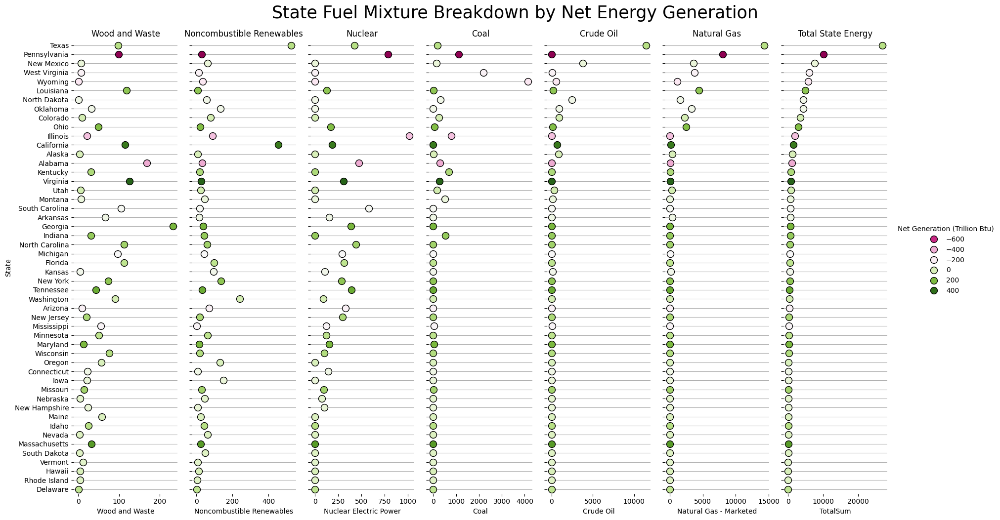

In [49]:
g = sns.PairGrid(
    state_type_wide_sorted,
    x_vars=column_order,
    y_vars="State",
    height=10,
    aspect=0.25,
    hue="Net Generation",
    palette="PiYG", # bwr_r
)


g.map(
    sns.stripplot,
    size=10,
    orient="h",
    jitter=False,
    # palette='flare_r',
    linewidth=1,
    edgecolor="black",
)

g.figure.suptitle('State Fuel Mixture Breakdown by Net Energy Generation', y=1.05, fontsize=25)
g.add_legend(title='Net Generation (Trillion Btu)')

titles = [
    "Wood and Waste",
    "Noncombustible Renewables",
    "Nuclear",
    "Coal",
    "Crude Oil",
    "Natural Gas",
    "Total State Energy",
]

for ax, title in zip(g.axes.flat, titles):

    ax.set(title=title)

    ax.xaxis.grid(False)
    ax.yaxis.grid(True)

sns.despine(left=True, bottom=True)

### Grid Reliability Assessment
*Comprehensive study of SAIFI, SAIDI, and CAIDI metrics over time*

In [65]:
STATE_ENCODINGS = {
    'AL': 'Alabama', 'AK': 'Alaska', 'AZ': 'Arizona', 'AR': 'Arkansas',
    'CA': 'California', 'CO': 'Colorado', 'CT': 'Connecticut', 'DE': 'Delaware',
    'FL': 'Florida', 'GA': 'Georgia', 'HI': 'Hawaii', 'ID': 'Idaho',
    'IL': 'Illinois', 'IN': 'Indiana', 'IA': 'Iowa', 'KS': 'Kansas',
    'KY': 'Kentucky', 'LA': 'Louisiana', 'ME': 'Maine', 'MD': 'Maryland',
    'MA': 'Massachusetts', 'MI': 'Michigan', 'MN': 'Minnesota', 'MS': 'Mississippi',
    'MO': 'Missouri', 'MT': 'Montana', 'NE': 'Nebraska', 'NV': 'Nevada',
    'NH': 'New Hampshire', 'NJ': 'New Jersey', 'NM': 'New Mexico', 'NY': 'New York',
    'NC': 'North Carolina', 'ND': 'North Dakota', 'OH': 'Ohio', 'OK': 'Oklahoma',
    'OR': 'Oregon', 'PA': 'Pennsylvania', 'RI': 'Rhode Island', 'SC': 'South Carolina',
    'SD': 'South Dakota', 'TN': 'Tennessee', 'TX': 'Texas', 'UT': 'Utah',
    'VT': 'Vermont', 'VA': 'Virginia', 'WA': 'Washington', 'WV': 'West Virginia',
    'WI': 'Wisconsin', 'WY': 'Wyoming', 'DC': 'District of Columbia'
}

REGION_ENCODINGS = {
    'East': ['CT', 'DE', 'ME', 'MD', 'MA', 'NH', 'NJ', 'NY', 'PA', 'RI', 'VT'],
    'Midwest': ['IL', 'IN', 'IA', 'KS', 'MI', 'MN', 'MO', 'NE', 'ND', 'OH', 'SD', 'WI'],
    'South': ['AL', 'AR', 'FL', 'GA', 'KY', 'LA', 'MS', 'NC', 'SC', 'TN', 'VA', 'WV'],
    'Southwest': ['AZ', 'NM', 'OK', 'TX'],
    'West': ['CA', 'CO', 'ID', 'MT', 'NV', 'OR', 'UT', 'WA', 'WY'],
    'Noncontiguous': ['HI', 'AK']
}

REGION_ENCODINGS_FULL = {
    'East': [STATE_ENCODINGS[code] for code in REGION_ENCODINGS['East']],
    'Midwest': [STATE_ENCODINGS[code] for code in REGION_ENCODINGS['Midwest']],
    'South': [STATE_ENCODINGS[code] for code in REGION_ENCODINGS['South']],
    'Southwest': [STATE_ENCODINGS[code] for code in REGION_ENCODINGS['Southwest']],
    'West': [STATE_ENCODINGS[code] for code in REGION_ENCODINGS['West']],
    'Noncontiguous': [STATE_ENCODINGS[code] for code in REGION_ENCODINGS['Noncontiguous']]
}

In [66]:
saifi = pd.read_excel('data/SAIFI_by_State.xlsx', sheet_name = 0, header = 3)
saidi = pd.read_excel('data/SAIDI_by_State.xlsx', sheet_name = 0, header = 3)
caidi = pd.read_excel('data/CAIDI_by_State.xlsx', sheet_name = 0, header = 3)

In [67]:
saifi = pd.melt(saifi, id_vars = ['Census Division\nand State'], value_vars = list(year for year in range(2013, 2024)), var_name = 'Year', value_name = 'SAIFI')
saidi = pd.melt(saidi, id_vars = ['Census Division\nand State'], value_vars = list(year for year in range(2013, 2024)), var_name = 'Year', value_name = 'SAIDI')
caidi = pd.melt(caidi, id_vars = ['Census Division\nand State'], value_vars = list(year for year in range(2013, 2024)), var_name = 'Year', value_name = 'CAIDI')

In [68]:
on_cols = ['Census Division\nand State', 'Year']
reliability = saifi.merge(saidi, on = on_cols)
reliability = reliability.merge(caidi, on = on_cols)
reliability = reliability.rename(columns = {'Census Division\nand State': 'State'})

In [69]:
def apply_region_to_row(row):
  for region in REGION_ENCODINGS_FULL:
    if row['State'] in REGION_ENCODINGS_FULL[region]:
      return region
  return ''

reliability['Region'] = reliability.apply(apply_region_to_row, axis = 1)
reliability = reliability[reliability['Region'] != '']
reliability

,State,Year,SAIFI,SAIDI,CAIDI,Region
1,Connecticut,2013,0.931,179.6,193,East
2,Maine,2013,2.894,971.3,335.7,East
3,Massachusetts,2013,1.14,435.5,382.1,East
4,New Hampshire,2013,1.98,209.3,105.7,East
5,Rhode Island,2013,1.26,783.2,621.6,East
...,...,...,...,...,...,...
695,California,2023,1.409,352.5,250.2,West
696,Oregon,2023,0.808,122.9,152.1,West
697,Washington,2023,1.05,153.8,146.5,West
699,Alaska,2023,3.26,499.4,153.2,Noncontiguous


Text(0.5, 1.02, 'Reliability Metrics - Relationships')

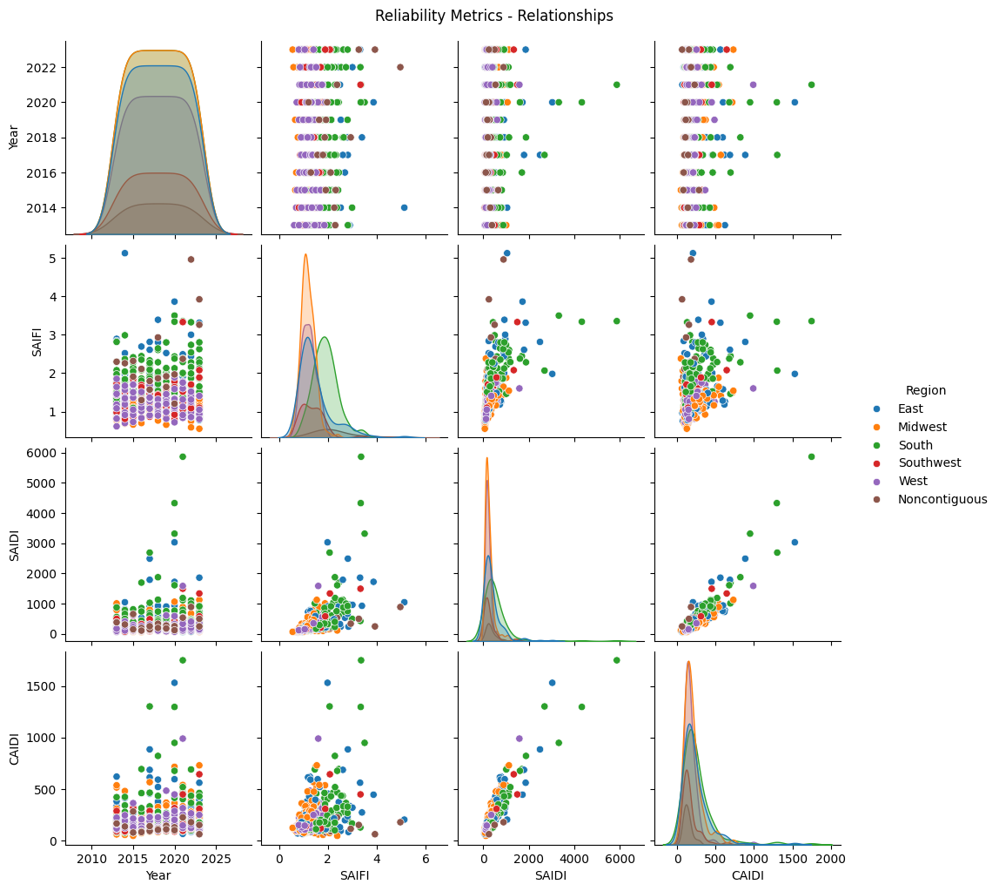

In [70]:
import seaborn as sns

reliability.loc[:, 'Year'] = pd.to_numeric(reliability['Year'], errors = 'coerce')
reliability.loc[:, 'SAIFI'] = pd.to_numeric(reliability['SAIFI'], errors = 'coerce')
reliability.loc[:, 'SAIDI'] = pd.to_numeric(reliability['SAIDI'], errors = 'coerce')
reliability.loc[:, 'CAIDI'] = pd.to_numeric(reliability['CAIDI'], errors = 'coerce')

pp = sns.pairplot(reliability[['Year', 'SAIFI', 'SAIDI', 'CAIDI', 'Region']], diag_kind = 'kde', hue = 'Region')
pp.fig.suptitle('Reliability Metrics - Relationships', y = 1.02)

Text(0.5, 1.0, 'Correlations Heatmap - Reliability Metrics')

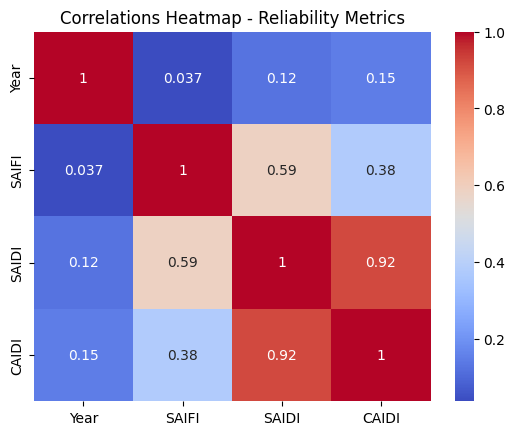

In [71]:
sns.heatmap(reliability[['Year', 'SAIFI', 'SAIDI', 'CAIDI']].corr(), cmap = 'coolwarm', annot = True)
plt.title('Correlations Heatmap - Reliability Metrics')

In [72]:
baseline = reliability[reliability['Year'] == 2013].set_index('State')[['SAIFI', 'SAIDI', 'CAIDI']]
metrics = ['SAIFI', 'SAIDI', 'CAIDI']
for metric in metrics:
   reliability[f'{metric}_Change'] = reliability.apply(lambda row: (row[metric] - baseline.loc[row['State'], metric]) / baseline.loc[row['State'], metric] * 100, axis=1)

C:\Users\murun\AppData\Local\Temp\ipykernel_18084\4056698125.py:18: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.


C:\Users\murun\AppData\Local\Temp\ipykernel_18084\4056698125.py:18: UserWarning:

Numpy array is not a supported type for `palette`. Please convert your palette to a list. This will become an error in v0.14

C:\Users\murun\AppData\Local\Temp\ipykernel_18084\4056698125.py:18: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.


C:\Users\murun\AppData\Local\Temp\ipykernel_18084\4056698125.py:18: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.


C:\Users\murun\AppData\Local\Temp

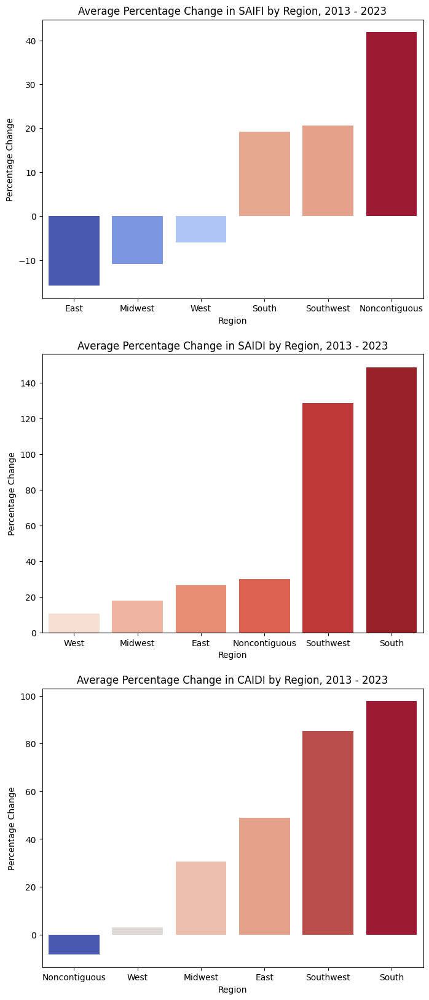

In [73]:
import matplotlib.colors as mcolors
import matplotlib.cm as cm

fig, axes = plt.subplots(3, 1, figsize=(8, 20))
reliability_end = reliability[reliability['Year'] == 2023]
change_metrics = ['SAIFI_Change', 'SAIDI_Change', 'CAIDI_Change']

for i, metric in enumerate(change_metrics):

  region_means = reliability_end.groupby('Region')[metric].mean().sort_values()

  if (region_means.min() < 0):
    color_slope = mcolors.TwoSlopeNorm(vmin = region_means.min(), vcenter = 0, vmax = region_means.max())
    colors = cm.coolwarm(color_slope(region_means.values))
  else:
    colors = 'Reds'

  sns.barplot(x = region_means.index, y = region_means.values, palette = colors, ax = axes[i])
  axes[i].set_xlabel('Region')
  axes[i].set_ylabel('Percentage Change')
  axes[i].set_title(f'Average Percentage Change in {metric[:5]} by Region, 2013 - 2023')


In [74]:
reliability[reliability['State'] == 'Hawaii']

,State,Year,SAIFI,SAIDI,CAIDI,Region,SAIFI_Change,SAIDI_Change,CAIDI_Change
60,Hawaii,2013,NaN,NaN,NaN,Noncontiguous,NaN,NaN,NaN
124,Hawaii,2014,NaN,NaN,NaN,Noncontiguous,NaN,NaN,NaN
188,Hawaii,2015,1.911,152.0,79.6,Noncontiguous,NaN,NaN,NaN
252,Hawaii,2016,1.3,109.3,84.1,Noncontiguous,NaN,NaN,NaN
316,Hawaii,2017,1.794,254.3,141.7,Noncontiguous,NaN,NaN,NaN
380,Hawaii,2018,1.867,198.0,106.1,Noncontiguous,NaN,NaN,NaN
444,Hawaii,2019,1.64,182.1,111.0,Noncontiguous,NaN,NaN,NaN
508,Hawaii,2020,1.207,123.8,102.5,Noncontiguous,NaN,NaN,NaN
572,Hawaii,2021,NaN,NaN,NaN,Noncontiguous,NaN,NaN,NaN
636,Hawaii,2022,NaN,NaN,NaN,Noncontiguous,NaN,NaN,NaN


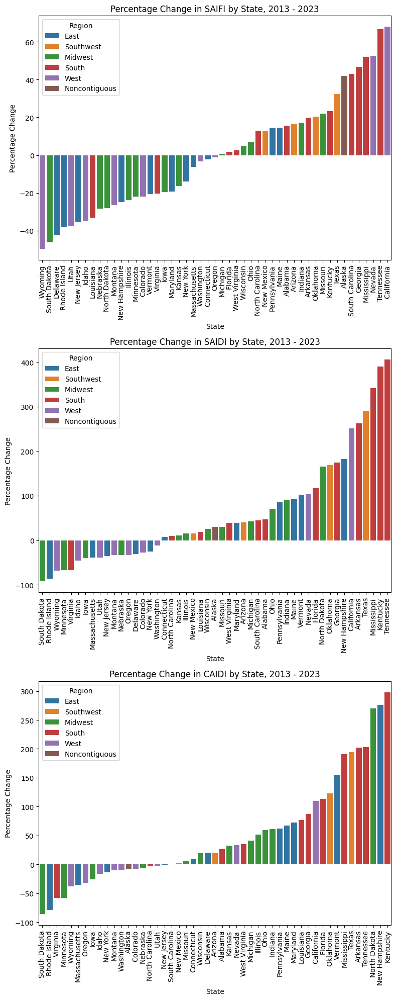

In [75]:
fig, axes = plt.subplots(3, 1, figsize=(8, 20))
reliability_end = reliability[reliability['Year'] == 2023]
reliability_end = reliability_end[reliability_end['State'] != 'Hawaii'] # No good data from 2013 - ignore.
region_order = ['East', 'Southwest', 'Midwest', 'South', 'West', 'Noncontiguous']

for i, metric in enumerate(change_metrics):
  reliability_end = reliability_end.sort_values(by = metric)

  sns.barplot(data = reliability_end, x = 'State', y = metric, hue = 'Region', hue_order = region_order, ax = axes[i])
  axes[i].set_xlabel('State')
  axes[i].set_ylabel('Percentage Change')
  axes[i].set_title(f'Percentage Change in {metric[:5]} by State, 2013 - 2023')
  axes[i].tick_params(axis = 'x', rotation = 90)

plt.tight_layout()

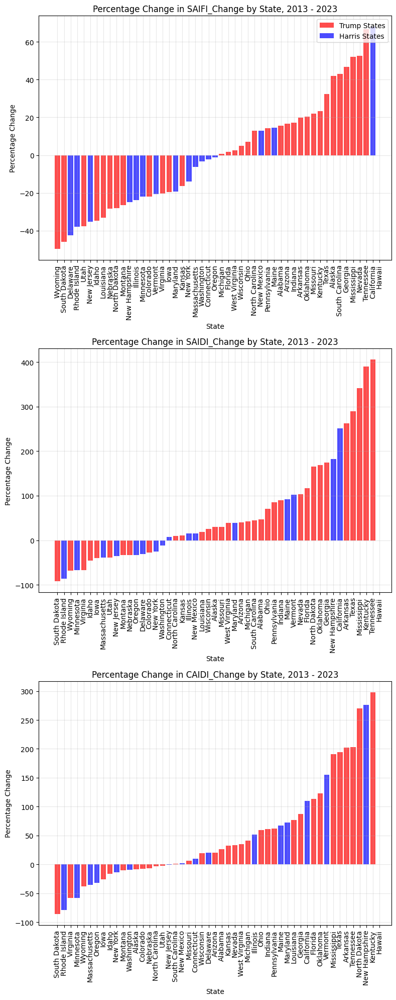

In [76]:
TRUMP_STATES_2024 = [
    'Alabama', 'Alaska', 'Arizona', 'Arkansas', 'Colorado', 'Florida', 'Georgia',
    'Idaho', 'Indiana', 'Iowa', 'Kansas', 'Kentucky', 'Louisiana', 'Michigan',
    'Mississippi', 'Missouri', 'Montana', 'Nebraska', 'Nevada', 'North Carolina',
    'North Dakota', 'Ohio', 'Oklahoma', 'Pennsylvania', 'South Carolina',
    'South Dakota', 'Tennessee', 'Texas', 'Utah', 'Virginia', 'West Virginia',
    'Wisconsin', 'Wyoming'
]
HARRIS_STATES_2024 = [
    'California', 'Connecticut', 'Delaware', 'District of Columbia', 'Hawaii',
    'Illinois', 'Maine', 'Maryland', 'Massachusetts', 'Minnesota', 'New Hampshire',
    'New Jersey', 'New Mexico', 'New York', 'Oregon', 'Rhode Island', 'Vermont',
    'Washington'
]

# Create a function to assign winner colors
def get_winner_color(state):
    if state in TRUMP_STATES_2024:
        return 'red'
    elif state in HARRIS_STATES_2024:
        return 'blue'
    else:
        return 'gray'  # fallback for any states not in either list

# Create winner column
reliability_end = reliability[reliability['Year'] == 2023].copy()
reliability_end['Winner'] = reliability_end['State'].apply(get_winner_color)

fig, axes = plt.subplots(3, 1, figsize=(8, 20))

for i, metric in enumerate(change_metrics):
    reliability_end = reliability_end.sort_values(by=metric)

    # Create the bar plot with winner-based colors
    bars = axes[i].bar(reliability_end['State'], reliability_end[metric],
                       color=reliability_end['Winner'], alpha=0.7)

    axes[i].set_xlabel('State')
    axes[i].set_ylabel('Percentage Change')
    axes[i].set_title(f'Percentage Change in {metric} by State, 2013 - 2023')
    axes[i].tick_params(axis='x', rotation=90)
    axes[i].grid(True, alpha=0.3)

    # Add legend for the first subplot
    if i == 0:
        from matplotlib.patches import Patch
        legend_elements = [Patch(facecolor='red', alpha=0.7, label='Trump States'),
                          Patch(facecolor='blue', alpha=0.7, label='Harris States')]
        axes[i].legend(handles=legend_elements, loc='upper right')

plt.tight_layout()
plt.show()

Mostly threw these in for fun, and cause I was curious, we don't have to include this if we don't feel like it. Mostly it's along the lines of what I thought - red states tend to have worse outcomes when it comes to reliability, though there's some big losers in the blue state category too, and it's far from a decisive claim. Running a nonparametric test would most likely point to a small observed effect.

My guess is that it's carrot and sticks. If you're a state that has almost no natural disasters and relatively few environmental problems, it's easy to resolve distribution issues when they pop up, so the investment is effective while also being cheap. But when half your state burns down or you get hit with a rather biblical flood, then solving distribution problems becomes very expensive very fast, which leads to downward trends.

Generally, it seems like about half the states are doing a good job and half the states are doing a bad job when it comes to preventing an increase in outages. However, few states seem to be winning when it comes to fighting outage duration.

In [78]:
import plotly.express as px

STATE_ENCODINGS_REVERSE = {v: k for k, v in STATE_ENCODINGS.items()}
reliability_end['State_Code'] = reliability_end['State'].map(STATE_ENCODINGS_REVERSE)

import plotly.express as px
fig = px.choropleth(reliability_end,
                    locations = 'State_Code',
                    locationmode = 'USA-states',
                    scope = 'usa',
                    color = 'SAIFI_Change',
                    color_continuous_scale = 'RdBu_r', # or 'oxy' RdBu
                    color_continuous_midpoint = 0,
                    title = 'SAIFI Percentage Changes - U.S., 2013 - 2023')
fig.show()

In [79]:
fig = px.choropleth(reliability_end,
                    locations = 'State_Code',
                    locationmode = 'USA-states',
                    scope = 'usa',
                    color = 'SAIDI_Change',
                    color_continuous_scale = 'RdBu_r', # or 'oxy' RdBu
                    color_continuous_midpoint = 0,
                    title = 'SAIDI Percentage Changes - U.S., 2013 - 2023')
fig.show()

In [80]:
fig = px.choropleth(reliability_end,
                    locations = 'State_Code',
                    locationmode = 'USA-states',
                    scope = 'usa',
                    color = 'CAIDI_Change',
                    color_continuous_scale = 'RdBu_r', # or 'oxy' RdBu
                    color_continuous_midpoint = 0,
                    title = 'CAIDI Percentage Changes - U.S., 2013 - 2023')
fig.show()

In [81]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px

#### State Fuel Mixture by Reliability

In [82]:
saidi_df = pd.read_excel('data/SAIDI_by_State.xlsx', sheet_name = 0, header = 3)

In [83]:
saidi_df = pd.melt(saidi_df, id_vars = ['Census Division\nand State'], value_vars = list(year for year in range(2023, 2024)), var_name = 'Year', value_name = 'SAIDI')

In [84]:
saidi_df = saidi_df.rename(
    columns={'Census Division\nand State': 'State'}
)

saidi_df.head(10)

,State,Year,SAIDI
0,New England,2023,489.3
1,Connecticut,2023,193.4
2,Maine,2023,1863.0
3,Massachusetts,2023,265.3
4,New Hampshire,2023,590.6
5,Rhode Island,2023,104.6
6,Vermont,2023,486.3
7,Middle Atlantic,2023,196.8
8,New Jersey,2023,108.2
9,New York,2023,204.8


In [85]:
# only get states, not regions
saidi_df = saidi_df[saidi_df['State'].isin(STATE_ENCODINGS.values())]

In [86]:
saidi_df = saidi_df.sort_values(by='State')

In [87]:
saidi_df = saidi_df.reset_index(drop=True)

In [88]:
saidi_df = saidi_df.drop('Year', axis=1)

In [89]:
saidi_df.head(10)

,State,SAIDI
0,Alabama,400.2
1,Alaska,499.4
2,Arizona,103.8
3,Arkansas,915.3
4,California,352.5
5,Colorado,100.2
6,Connecticut,193.4
7,Delaware,109.7
8,District of Columbia,71.9
9,Florida,172.3


In [90]:
saidi_df['Reliability Category'] = pd.qcut(
    saidi_df['SAIDI'],
    q=[0, 0.25, 0.75, 1],
    labels=['stable', 'nominal', 'unstable']
)

In [91]:
saidi_df.head(10)

,State,SAIDI,Reliability Category
0,Alabama,400.2,nominal
1,Alaska,499.4,unstable
2,Arizona,103.8,stable
3,Arkansas,915.3,unstable
4,California,352.5,nominal
5,Colorado,100.2,stable
6,Connecticut,193.4,nominal
7,Delaware,109.7,stable
8,District of Columbia,71.9,stable
9,Florida,172.3,nominal


In [92]:
saidi_hue_cat = saidi_df.drop('SAIDI', axis=1)

In [93]:
state_type_wide = state_type_df.pivot(
    index='State',
    columns='Type',
    values='Generated'
)

state_type_wide = state_type_wide.reset_index() # reintroduce normal index

# join the state generation into fuel mixture
state_type_wide = pd.merge(state_type_wide, saidi_hue_cat[['State', 'Reliability Category']], on='State', how='left')

# create a sum energy total per state as new column
state_type_wide['TotalSum'] = state_type_wide[
    ['Coal', 'Natural Gas - Marketed', 'Crude Oil', 'Nuclear Electric Power', 'Wood and Waste', 'Noncombustible Renewables']
].sum(axis=1)

# force category ordering
state_type_wide_sorted = state_type_wide.sort_values(['Reliability Category', 'TotalSum'], ascending=False)
state_order = state_type_wide_sorted['State'].tolist()
state_type_wide_sorted['State'] = pd.Categorical(state_type_wide_sorted['State'], categories=state_order, ordered=True)

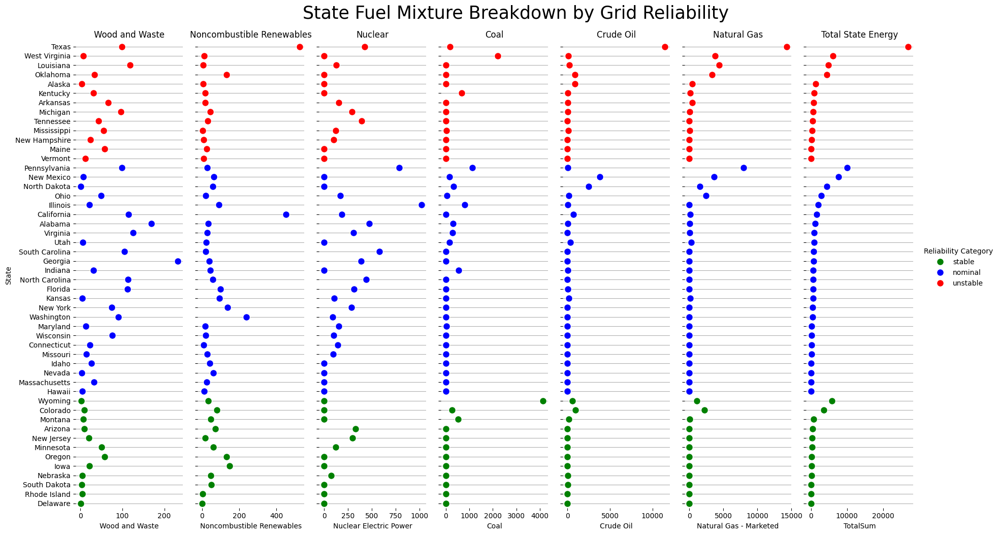

In [94]:
g = sns.PairGrid(
    state_type_wide_sorted,
    x_vars=column_order,
    y_vars="State",
    height=10,
    aspect=0.25,
    hue="Reliability Category",
    palette=["green", "blue", "red"],
)

g.map(
    sns.stripplot,
    size=10,
    orient="h",
    jitter=False,
    linewidth=1,
    edgecolor="w",
)

g.figure.suptitle('State Fuel Mixture Breakdown by Grid Reliability', y=1.05, fontsize=25)
g.add_legend()

titles = [
    "Wood and Waste",
    "Noncombustible Renewables",
    "Nuclear",
    "Coal",
    "Crude Oil",
    "Natural Gas",
    "Total State Energy",
]

for ax, title in zip(g.axes.flat, titles):

    ax.set(title=title)

    ax.xaxis.grid(False)
    ax.yaxis.grid(True)

sns.despine(left=True, bottom=True)

#### State Energy Production and Reliability on Map

In [95]:
state_energy_saidi = state_type_wide_sorted[['State', 'TotalSum', 'Reliability Category']]

In [96]:
state_energy_saidi['State'] = state_energy_saidi['State'].cat.rename_categories(STATE_NAMES);

C:\Users\murun\AppData\Local\Temp\ipykernel_18084\2374090468.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [97]:
fig = px.scatter_geo(
    state_energy_saidi,
    locations="State",
    locationmode="USA-states",
    size="TotalSum",
    color="Reliability Category",
    #hover_name="State"
    #hover_data=["TotalSum", "Reliability Category"],
    title="State Energy Production and Reliability",
    color_discrete_sequence=['red', 'blue', 'green'],
    #color_continuous_scale=px.colors.sequential.Bluyl,
    projection="albers usa",
)

fig.show()

In [98]:
fig = px.choropleth(
    state_energy_saidi,
    locations="State",
    locationmode="USA-states",
    #size="TotalSum",
    color="Reliability Category",
    #hover_name="State",
    #hover_data=["TotalSum", "Reliability Category"],
    title="State Reliability",
    color_discrete_sequence=['pink', 'lightblue', 'lightgreen'],
    #color_continuous_scale=px.colors.sequential.Bluyl,
    projection="albers usa",
)

fig.show()

### Energy Pricing Trends
*Sector-specific cost analysis and regional price variations*

In [99]:
## Load costs and divide into subsets based on region
costs = pd.read_excel('data/Costs by State and Year.xlsx', sheet_name = 'Total Electric Industry', header = 2)

costs_us = costs[costs['STATE'] == 'US']
costs_northeast = costs[costs['STATE'].isin(REGION_ENCODINGS['East'])]
costs_midwest = costs[costs['STATE'].isin(REGION_ENCODINGS['Midwest'])]
costs_southeast = costs[costs['STATE'].isin(REGION_ENCODINGS['South'])]
costs_southwest = costs[costs['STATE'].isin(REGION_ENCODINGS['Southwest'])]
costs_west = costs[costs['STATE'].isin(REGION_ENCODINGS['West'])]
costs_noncontinguous = costs[costs['STATE'].isin(REGION_ENCODINGS['Noncontiguous'])]

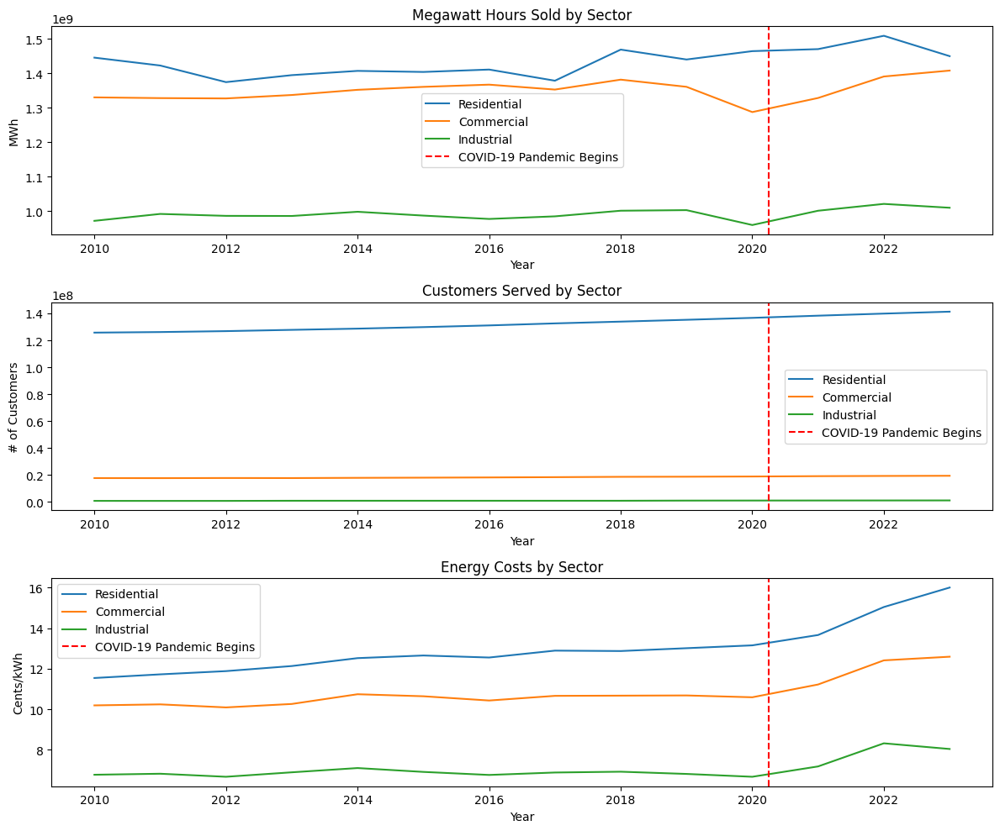

In [100]:
fig, axs = plt.subplots(3, 1, figsize = (12, 10))

axs[0].plot(costs_us['Year'], costs_us['Megawatthours'], label = 'Residential')
axs[0].plot(costs_us['Year'], costs_us['Megawatthours.1'], label = 'Commercial')
axs[0].plot(costs_us['Year'], costs_us['Megawatthours.2'], label = 'Industrial')
axs[0].axvline(x = 2020.25, linestyle = '--', color = 'red', label = 'COVID-19 Pandemic Begins')
axs[0].set_title('Megawatt Hours Sold by Sector')
axs[0].set_xlabel('Year')
axs[0].set_ylabel('MWh')
axs[0].legend()

axs[1].plot(costs_us['Year'], costs_us['Count'], label = 'Residential')
axs[1].plot(costs_us['Year'], costs_us['Count.1'], label = 'Commercial')
axs[1].plot(costs_us['Year'], costs_us['Count.2'], label = 'Industrial')
axs[1].axvline(x = 2020.25, linestyle = '--', color = 'red', label = 'COVID-19 Pandemic Begins')
axs[1].set_title('Customers Served by Sector')
axs[1].set_xlabel('Year')
axs[1].set_ylabel('# of Customers')
axs[1].legend()

axs[2].plot(costs_us['Year'], costs_us['Cents/kWh'], label = 'Residential')
axs[2].plot(costs_us['Year'], costs_us['Cents/kWh.1'], label = 'Commercial')
axs[2].plot(costs_us['Year'], costs_us['Cents/kWh.2'], label = 'Industrial')
axs[2].axvline(x = 2020.25, linestyle = '--', color = 'red', label = 'COVID-19 Pandemic Begins')
axs[2].set_title('Energy Costs by Sector')
axs[2].set_xlabel('Year')
axs[2].set_ylabel('Cents/kWh')
axs[2].legend()

plt.tight_layout()

In [101]:
costs_northeast['Cents/kWh']

6      29.88
8      15.73
19     29.61
20     16.60
21     27.42
       ...  
707    16.57
710    18.74
714    12.70
715    15.92
722    15.57
Name: Cents/kWh, Length: 154, dtype: float64

In [102]:
costs

,Year,STATE,Thousand Dollars,Megawatthours,Count,Cents/kWh,Thousand Dollars.1,Megawatthours.1,Count.1,Cents/kWh.1,...,Count.2,Cents/kWh.2,Thousand Dollars.3,Megawatthours.3,Count.3,Cents/kWh.3,Thousand Dollars.4,Megawatthours.4,Count.4,Cents/kWh.4
0,2023,AK,490072,2050667,296192,23.90,543148,2602872,56796,20.87,...,1161,18.70,0,0,0,0.00,1289606,6024598,354149,21.41
1,2023,AL,4593824,31409652,2353274,14.63,2923959,22213494,384122,13.16,...,7239,7.11,0,0,0,0.00,9738604,84880359,2744635,11.47
2,2023,AR,2251157,18373971,1459802,12.25,1208919,11694057,205526,10.34,...,36612,6.87,40,268,2,14.93,4735966,48649300,1701942,9.73
3,2023,AZ,5466059,38992365,3068552,14.02,3844785,32619680,344059,11.79,...,7614,8.11,1008,10066,2,10.01,10470980,85918798,3420227,12.19
4,2023,CA,24439806,82820898,14063972,29.51,27006847,112935566,1766915,23.91,...,148000,18.64,94387,725431,12,13.01,59555424,239480452,15978899,24.87
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
723,2010,WA,2805591,34906926,2825281,8.04,2125160,28833281,353330,7.37,...,27970,4.08,516,6949,6,7.42,6016578,90379970,3206587,6.66
724,2010,WI,2820621,22299493,2594698,12.65,2296381,23001117,338406,9.98,...,4496,6.85,0,0,0,0.00,6723234,68752417,2937600,9.78
725,2010,WV,1094174,12442583,867948,8.79,610027,7961906,137209,7.66,...,12348,5.86,365,4380,1,8.33,2385580,32031803,1017506,7.45
726,2010,WY,239198,2727201,257447,8.77,320135,4317140,59642,7.42,...,8933,4.98,0,0,0,0.00,1060618,17113458,326022,6.20


Text(0.5, 1.0, 'Residential U.S. Energy Costs 2010-2013, by State')

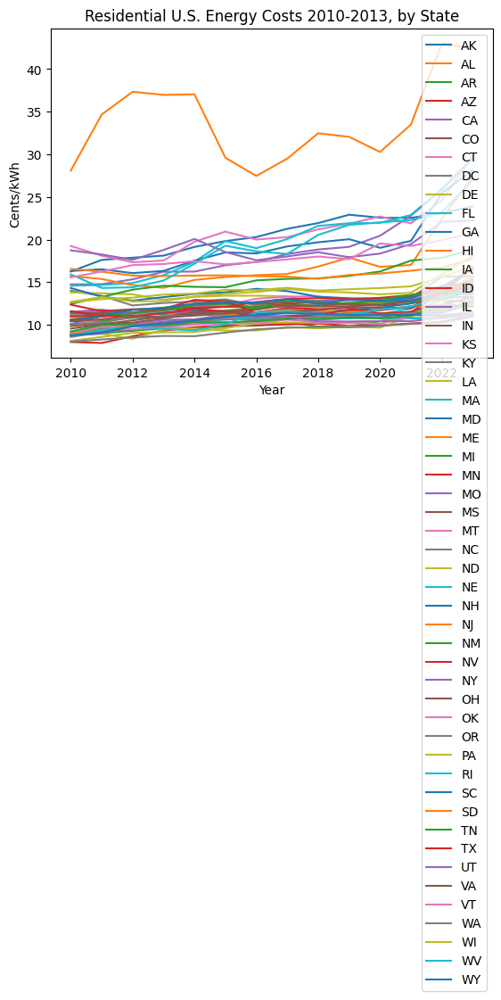

In [103]:
import matplotlib.pyplot as plt
states = [s for s in list(set(costs['STATE'])) if s != 'US']
states.sort()
for state in states:
  costs_for_state = costs[costs['STATE'] == state]
  plt.plot(costs_for_state['Year'], costs_for_state['Cents/kWh'], label = state)
plt.legend()
plt.xlabel('Year')
plt.ylabel('Cents/kWh')
plt.title('Residential U.S. Energy Costs 2010-2013, by State')

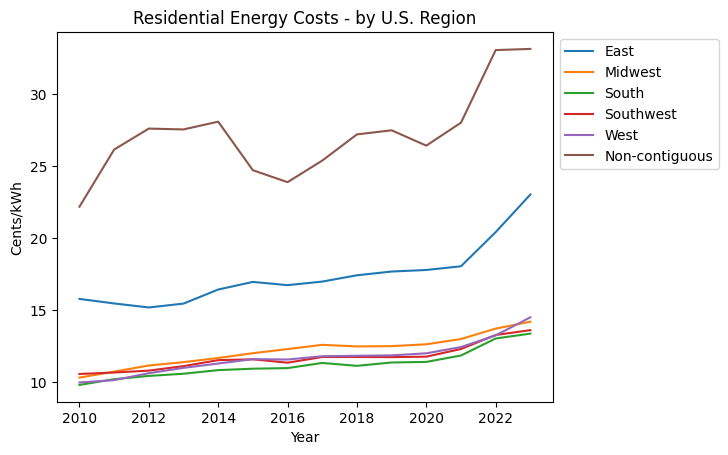

In [104]:
def plot_costs_by_region(measure, type):
  plt.plot(costs_northeast[['Year', measure]].groupby('Year').mean()[measure], label='East')
  plt.plot(costs_midwest[['Year', measure]].groupby('Year').mean()[measure], label='Midwest')
  plt.plot(costs_southeast[['Year', measure]].groupby('Year').mean()[measure], label='South')
  plt.plot(costs_southwest[['Year', measure]].groupby('Year').mean()[measure], label='Southwest')
  plt.plot(costs_west[['Year', measure]].groupby('Year').mean()[measure], label='West')
  plt.plot(costs_noncontinguous[['Year', measure]].groupby('Year').mean()[measure], label='Non-contiguous')
  plt.title(f'{type} Energy Costs - by U.S. Region')
  plt.xlabel('Year')
  plt.ylabel('Cents/kWh')
  plt.legend(bbox_to_anchor = (1, 1))

plot_costs_by_region('Cents/kWh', 'Residential')

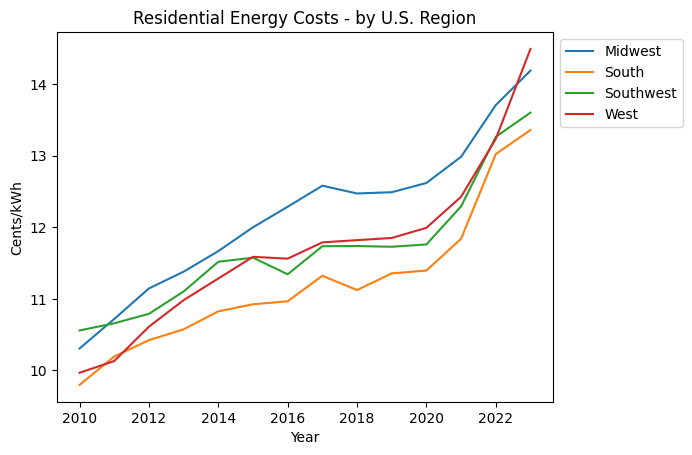

In [105]:
def plot_costs_by_region_excl(measure, type):
  #plt.plot(costs_northeast[['Year', measure]].groupby('Year').mean()[measure], label='East')
  plt.plot(costs_midwest[['Year', measure]].groupby('Year').mean()[measure], label='Midwest')
  plt.plot(costs_southeast[['Year', measure]].groupby('Year').mean()[measure], label='South')
  plt.plot(costs_southwest[['Year', measure]].groupby('Year').mean()[measure], label='Southwest')
  plt.plot(costs_west[['Year', measure]].groupby('Year').mean()[measure], label='West')
  #plt.plot(costs_noncontinguous[['Year', measure]].groupby('Year').mean()[measure], label='Non-contiguous')
  plt.title(f'{type} Energy Costs - by U.S. Region')
  plt.xlabel('Year')
  plt.ylabel('Cents/kWh')
  plt.legend(bbox_to_anchor = (1, 1))

plot_costs_by_region_excl('Cents/kWh', 'Residential')

None

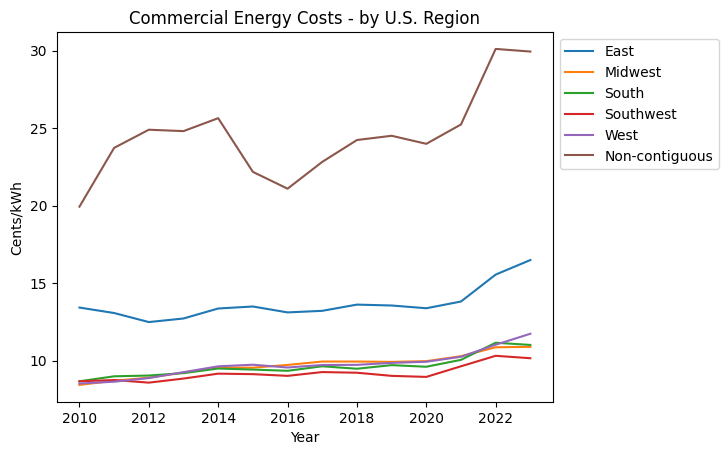

In [106]:
display(plot_costs_by_region('Cents/kWh.1', 'Commercial'))

None

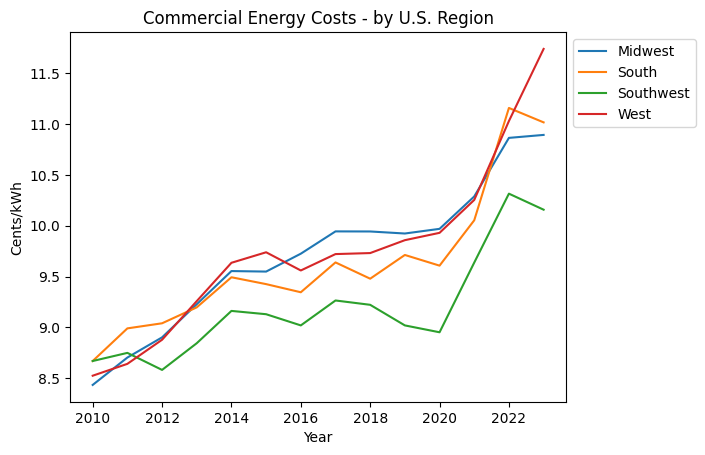

In [107]:
display(plot_costs_by_region_excl('Cents/kWh.1', 'Commercial'))

None

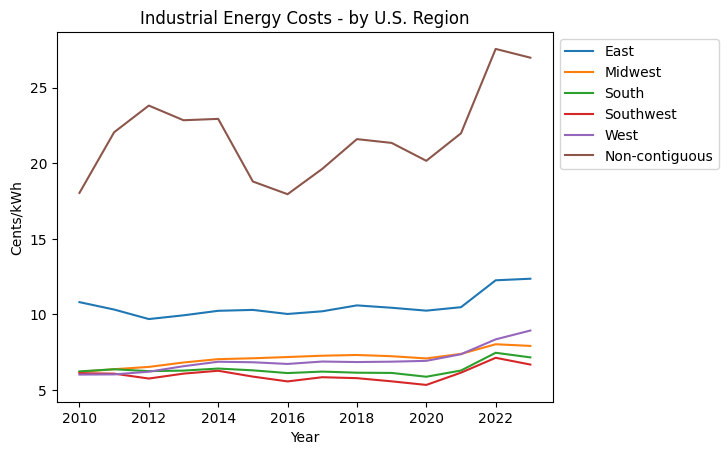

In [108]:
display(plot_costs_by_region('Cents/kWh.2', 'Industrial'))

None

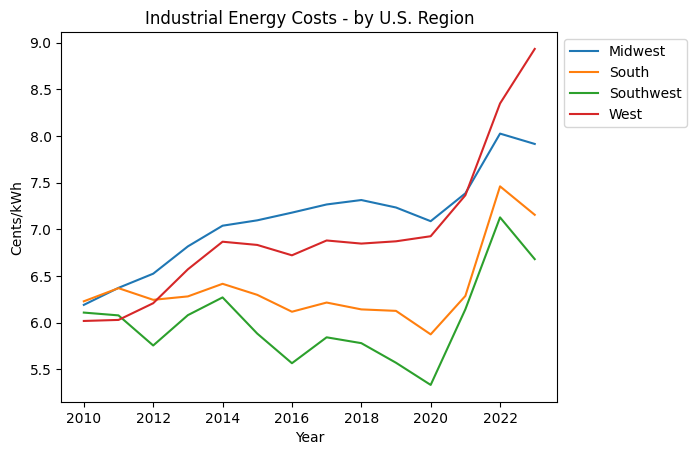

In [109]:
display(plot_costs_by_region_excl('Cents/kWh.2', 'Industrial'))

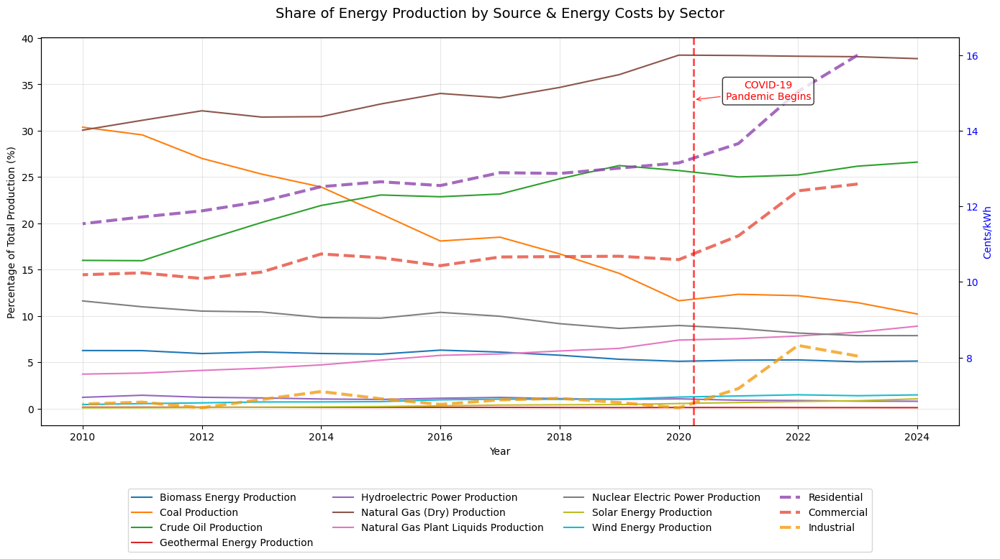

In [110]:
clean_df_filtered = clean_df[clean_df['Date'].dt.year > 2009]

# Pivot the table to have the Date as index and descriptions as columns
pivot_df = clean_df_filtered.pivot_table(index='Year', columns='Description', values='Value', aggfunc='sum')

# Calculate the total production for each year
yearly_total = pivot_df.sum(axis=1)

# Normalize the data by dividing each source's value by the yearly total
normalized_df = pivot_df.div(yearly_total, axis=0).multiply(100).fillna(0)

# Create the figure and primary axis
fig, ax1 = plt.subplots(figsize=(14, 8))

# Plot the energy production share on primary y-axis with improved styling
for i, column in enumerate(normalized_df.columns):
    ax1.plot(normalized_df.index, normalized_df[column],
             label=column)

# Configure primary y-axis
ax1.set_xlabel('Year')
ax1.set_ylabel('Percentage of Total Production (%)', color='black')
ax1.tick_params(axis='y', labelcolor='black')
ax1.grid(True, alpha=0.3)

# Create secondary y-axis for costs
ax2 = ax1.twinx()

# Define distinct colors and styles for cost lines
cost_colors = ['#8E44AD', '#E74C3C', '#F39C12']

# Plot the cost data on secondary y-axis with improved styling
ax2.plot(costs_us['Year'], costs_us['Cents/kWh'],
         label='Residential', linestyle='--', linewidth=3,
         color=cost_colors[0], alpha=0.8)
ax2.plot(costs_us['Year'], costs_us['Cents/kWh.1'],
         label='Commercial', linestyle='--', linewidth=3,
         color=cost_colors[1], alpha=0.8)
ax2.plot(costs_us['Year'], costs_us['Cents/kWh.2'],
         label='Industrial', linestyle='--', linewidth=3,
         color=cost_colors[2], alpha=0.8)

# COVID annotation
ax2.axvline(x=2020.25, linestyle='--', color='red', alpha=0.7, linewidth=2)
# Add annotation text
ax2.annotate('COVID-19\nPandemic Begins',
             xy=(2020.25, ax2.get_ylim()[1] * 0.9),
             xytext=(2021.5, ax2.get_ylim()[1] * 0.9),
             arrowprops=dict(arrowstyle='->', color='red', alpha=0.7),
             fontsize=10, color='red', ha='center',
             bbox=dict(boxstyle="round,pad=0.3", facecolor='white', alpha=0.8, edgecolor='black'))

# Configure secondary y-axis
ax2.set_ylabel('Cents/kWh', color='blue')
ax2.tick_params(axis='y', labelcolor='blue')

# Set title
plt.title('Share of Energy Production by Source & Energy Costs by Sector', fontsize=14, pad=20)

# Combine legends from both axes (excluding COVID line)
lines1, labels1 = ax1.get_legend_handles_labels()
lines2, labels2 = ax2.get_legend_handles_labels()
ax1.legend(lines1 + lines2, labels1 + labels2,
          bbox_to_anchor=(0.5, -0.15), loc='upper center', ncol=4)

plt.tight_layout()
plt.show()

### That's all, folks!